# Imports

In [59]:
import pandas as pd
import numpy as np
import pathlib
import matplotlib.pyplot as plt
import scipy
import sys
import pickle
import IPython
import random
import librosa
import librosa.display as lplt
import seaborn as sns

import sklearn
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import normalize
from sklearn.preprocessing import minmax_scale
from sklearn.feature_selection import mutual_info_classif
from sklearn.neighbors import KNeighborsClassifier
from sklearn.feature_selection import RFECV
from sklearn.model_selection import GridSearchCV, RepeatedStratifiedKFold
from sklearn.metrics import accuracy_score, confusion_matrix, ConfusionMatrixDisplay

import plotly.express as px


import tensorflow as tf
from tensorflow import keras

In [60]:
random.seed(42)

In [3]:
str(pathlib.Path().resolve())

'/home/aduer/projet_4'

# DataFrame with the signals

In [61]:
data = pd.read_csv('features_30_sec.csv')

In [62]:
data.drop('filename', axis = 1, inplace = True)

In [63]:
data.shape

(1000, 59)

In [64]:
data.isnull().sum(axis = 1).sum() # number of null values in each row

0

In [65]:
data.isnull().sum(axis = 0).sum() # number of null values in each column

0

In [66]:
data.head(n = 10)

,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,661794,0.350088,0.088757,0.130228,0.002827,1784.165850,1.297741e+05,2002.449060,85882.761315,3805.839606,...,52.420910,-1.690215,36.524071,-0.408979,41.597103,-2.303523,55.062923,1.221291,46.936035,blues
1,661794,0.340914,0.094980,0.095948,0.002373,1530.176679,3.758501e+05,2039.036516,213843.755497,3550.522098,...,55.356403,-0.731125,60.314529,0.295073,48.120598,-0.283518,51.106190,0.531217,45.786282,blues
2,661794,0.363637,0.085275,0.175570,0.002746,1552.811865,1.564676e+05,1747.702312,76254.192257,3042.260232,...,40.598766,-7.729093,47.639427,-1.816407,52.382141,-3.439720,46.639660,-2.231258,30.573025,blues
3,661794,0.404785,0.093999,0.141093,0.006346,1070.106615,1.843559e+05,1596.412872,166441.494769,2184.745799,...,44.427753,-3.319597,50.206673,0.636965,37.319130,-0.619121,37.259739,-3.407448,31.949339,blues
4,661794,0.308526,0.087841,0.091529,0.002303,1835.004266,3.433999e+05,1748.172116,88445.209036,3579.757627,...,86.099236,-5.454034,75.269707,-0.916874,53.613918,-4.404827,62.910812,-11.703234,55.195160,blues
5,661794,0.302456,0.087532,0.103494,0.003981,1831.993940,1.030482e+06,1729.653287,201910.508633,3481.517592,...,72.549225,-1.838263,68.702026,-2.783800,42.447453,-3.047909,39.808784,-8.109991,46.311005,blues
6,661794,0.291328,0.093981,0.141874,0.008803,1459.366472,4.378594e+05,1389.009131,185023.239545,2795.610963,...,83.248245,-10.913176,56.902153,-6.971336,38.231800,-3.436505,48.235741,-6.483466,70.170364,blues
7,661794,0.307955,0.092903,0.131822,0.005531,1451.667066,4.495682e+05,1577.270941,168211.938804,2954.836760,...,70.438438,-10.568935,52.090893,-10.784515,60.461330,-4.690678,65.547516,-8.630722,56.401436,blues
8,661794,0.408879,0.086512,0.142416,0.001507,1719.368948,1.632828e+05,2031.740381,105542.718193,3782.316288,...,50.563751,-7.041824,28.894934,2.695248,36.889568,3.412305,33.698597,-2.715692,36.418430,blues
9,661794,0.273950,0.092316,0.081314,0.004347,1817.150863,2.982361e+05,1973.773306,114070.112591,3943.490565,...,59.314602,-1.916804,58.418438,-2.292661,83.205231,2.881967,77.082222,-4.235203,91.468811,blues


In [67]:
round(data.describe(), 4)

,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,...,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
count,1000.000,1000.0000,1000.0000,1000.0000,1000.0000,1000.0000,1.000000e+03,1000.0000,1000.0000,1000.0000,...,1000.0000,1000.0000,1000.0000,1000.0000,1000.0000,1000.0000,1000.0000,1000.0000,1000.0000,1000.0000
mean,662030.846,0.3787,0.0863,0.1309,0.0031,2201.7809,4.696916e+05,2242.5411,137079.1552,4571.5493,...,1.1481,60.7310,-3.9660,62.6336,0.5077,63.7126,-2.3288,66.2319,-1.0953,70.1261
std,1784.074,0.0817,0.0077,0.0657,0.0036,715.9606,4.008995e+05,526.3165,96455.6663,1574.7916,...,4.5789,33.7820,4.5497,33.4792,3.8691,34.4020,3.7560,37.1746,3.8370,45.2285
min,660000.000,0.1719,0.0446,0.0053,0.0000,570.0404,7.911251e+03,898.0662,10787.1851,749.1406,...,-15.6938,9.1693,-17.2347,13.9315,-11.9637,15.4206,-18.5020,13.4876,-19.9296,7.9566
25%,661504.000,0.3196,0.0823,0.0867,0.0009,1627.6973,1.843505e+05,1907.2406,67376.5544,3380.0696,...,-1.8633,40.3764,-7.2072,40.8309,-2.0070,41.8842,-4.6629,41.7102,-3.3690,42.3729
50%,661794.000,0.3831,0.0866,0.1224,0.0018,2209.2631,3.384862e+05,2221.3928,111977.5480,4658.5245,...,1.2128,52.3251,-4.0656,54.7177,0.6696,54.8049,-2.3939,57.4231,-1.1663,59.1861
75%,661794.000,0.4359,0.0913,0.1757,0.0036,2691.2947,6.121479e+05,2578.4698,182371.5768,5533.8105,...,4.3597,71.6918,-0.8387,75.0408,3.1192,75.3858,0.1506,78.6264,1.3126,85.3754
max,675808.000,0.6637,0.1081,0.3980,0.0277,4435.2439,3.036843e+06,3509.6464,694784.8115,8677.6727,...,13.4572,392.9324,11.4829,406.0589,15.3884,332.9054,14.6949,393.1620,15.3696,506.0652


In [68]:
data.info() # numerical variables only except the target.

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 59 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   length                   1000 non-null   int64  
 1   chroma_stft_mean         1000 non-null   float64
 2   chroma_stft_var          1000 non-null   float64
 3   rms_mean                 1000 non-null   float64
 4   rms_var                  1000 non-null   float64
 5   spectral_centroid_mean   1000 non-null   float64
 6   spectral_centroid_var    1000 non-null   float64
 7   spectral_bandwidth_mean  1000 non-null   float64
 8   spectral_bandwidth_var   1000 non-null   float64
 9   rolloff_mean             1000 non-null   float64
 10  rolloff_var              1000 non-null   float64
 11  zero_crossing_rate_mean  1000 non-null   float64
 12  zero_crossing_rate_var   1000 non-null   float64
 13  harmony_mean             1000 non-null   float64
 14  harmony_var              

# Vizualizing Audio File (one sample example)

In [12]:
audio = str(pathlib.Path().resolve()) + "/Data/genres_original/blues/blues.00012.wav" # It's an example from our dataset :)

In [13]:
x, sr = librosa.load(audio, sr = 2 * 22050) 
# (time series, sr) ; sr -> sample rate, sample per second, here 44100 samples per second listening (frequency) but human beings ~ 22050 := 22.05 kHz

In [14]:
x.shape, sr 

((1323588,), 44100)

In [15]:
IPython.display.Audio(x, rate = sr)

## Waveform plot

In [16]:
# https://ask.audio/articles/audio-fundamentals-what-is-a-waveform-graph
# https://en.wikipedia.org/wiki/Waveform

In [17]:
# https://librosa.org/doc/main/generated/librosa.display.waveshow.html

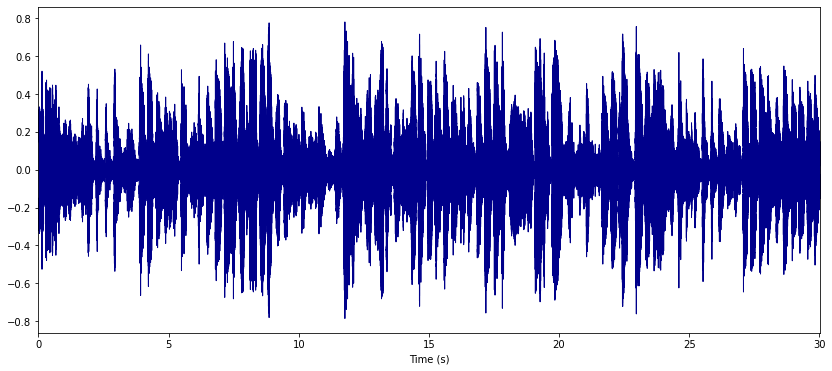

In [18]:
plt.figure(figsize = (14, 6))
librosa.display.waveplot(x, color = "darkblue", x_axis = 's', sr = sr)
plt.show()

## Spectrograms

In [19]:
# https://en.wikipedia.org/wiki/Spectrogram
# https://pnsn.org/spectrograms/what-is-a-spectrogram
# https://www.izotope.com/en/learn/understanding-spectrograms.html

### Spectrograms using Hz scale

In [20]:
# http://librosa.org/doc/main/generated/librosa.stft.html
# https://librosa.org/doc/main/generated/librosa.display.specshow.html

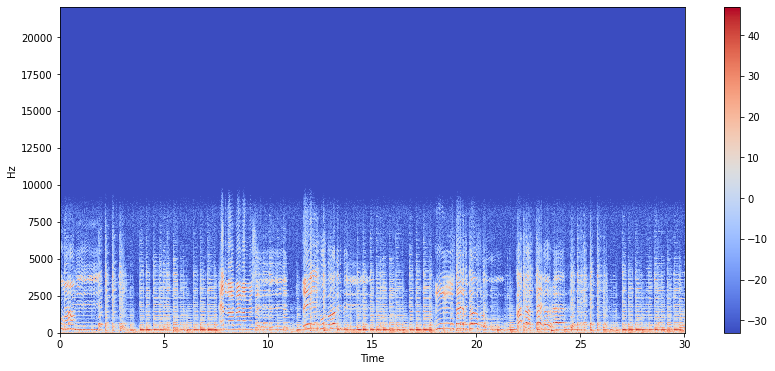

In [21]:
plt.figure(figsize = (14, 6))
stft = librosa.stft(x)
stft_db = librosa.amplitude_to_db(abs(stft))
librosa.display.specshow(stft_db, sr = sr, x_axis = 'time', y_axis = 'hz')
plt.colorbar()

### Spectrograms using log Hz scale

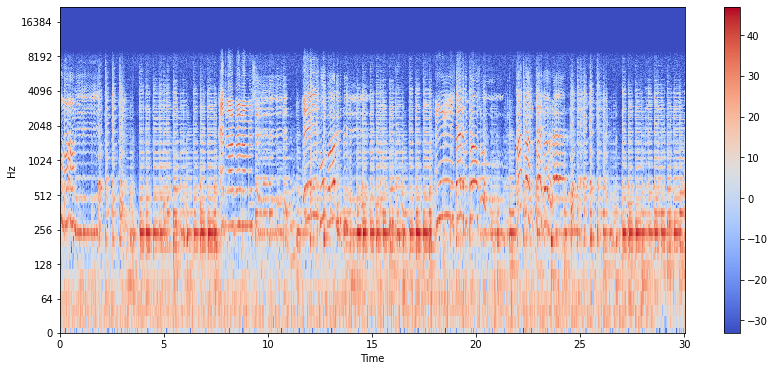

In [22]:
# Since the frequency is focused on small values
stft = librosa.stft(x)
stft_db = librosa.amplitude_to_db(abs(stft))
plt.figure(figsize = (14, 6))
librosa.display.specshow(stft_db, sr = sr, x_axis = 'time', y_axis = 'log')
plt.colorbar()

## Spectral Centroid

In [23]:
# https://en.wikipedia.org/wiki/Spectral_centroid
# https://www.actorproject.org/tor/timbre-lingo/2019/3/29/spectral-centroid
# https://ccrma.stanford.edu/~unjung/AIR/areaExam.pdf

In [24]:
# http://librosa.org/doc/main/generated/librosa.feature.spectral_centroid.html
# https://librosa.org/doc/main/generated/librosa.frames_to_time.html

(2586,)


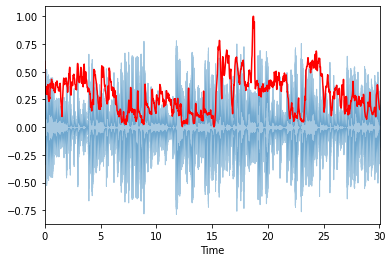

In [25]:
spectral_centroids = librosa.feature.spectral_centroid(x, sr=sr)[0]
print(spectral_centroids.shape)

# Computing the time variable for visualization
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)

# Normalising the spectral centroid for visualisation
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)

#Plotting the Spectral Centroid along the waveform
librosa.display.waveplot(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='r')

## Spectral Rolloff

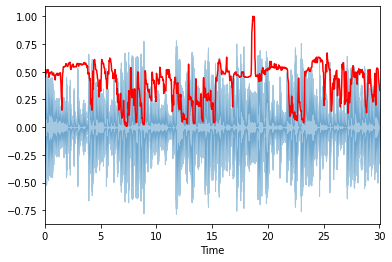

In [26]:
spectral_rolloff = librosa.feature.spectral_rolloff(x+0.01, sr=sr)[0]
librosa.display.waveplot(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='r')

## Chroma Feature

In [27]:
# https://en.wikipedia.org/wiki/Chroma_feature
# https://musicinformationretrieval.com/chroma.html

In [28]:
# https://librosa.org/doc/main/generated/librosa.feature.chroma_stft.html

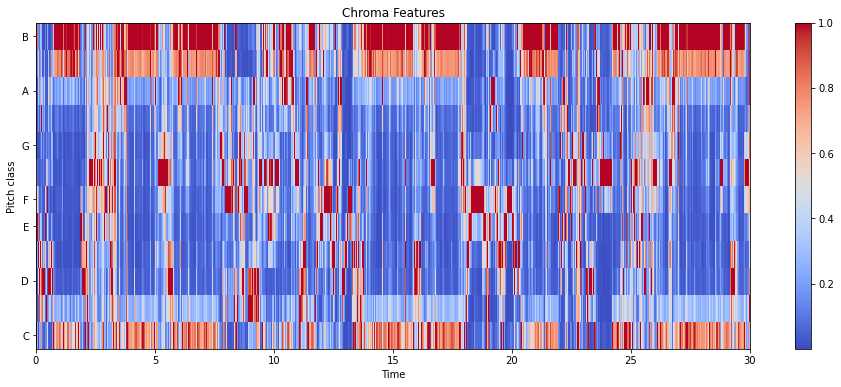

In [29]:
chroma = librosa.feature.chroma_stft(x, sr = sr)
plt.figure(figsize = (16, 6))
lplt.specshow(chroma, sr = sr, x_axis = 'time', y_axis = 'chroma', cmap = 'coolwarm')
plt.colorbar()
plt.title("Chroma Features")
plt.show()

## Zero Crossing Rate

In [30]:
# https://academic.microsoft.com/topic/2776860830
# https://en.wikipedia.org/wiki/Zero-crossing_rate
# https://musicinformationretrieval.com/zcr.html
# https://wiki.aalto.fi/display/ITSP/Zero-crossing+rate

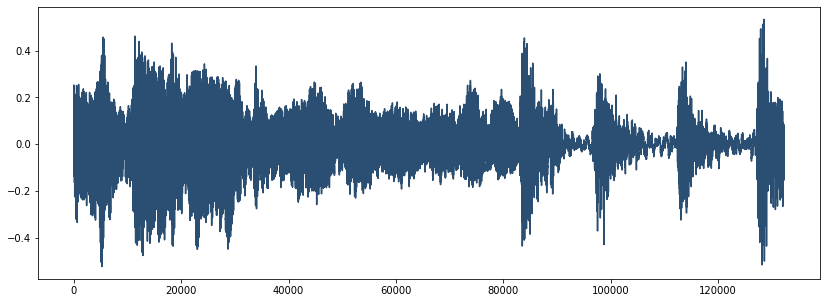

In [31]:
start = 0
end = 3 * sr # First three seconds ;)
plt.figure(figsize = (14, 5))
plt.plot(x[start:end], color = "#2B4F72")

In [32]:
zero_cross_rate = librosa.zero_crossings(x[start:end], pad = False)
print("The number of zero-crossings is:" , sum(zero_cross_rate))

The number of zero-crossings is: 6243


# Explanatory analysis

In [33]:
grouped_data = data.groupby(data['label']) # Data are grouped by label ;

## Descriptive statistics

### Correlation matrix

<AxesSubplot:>

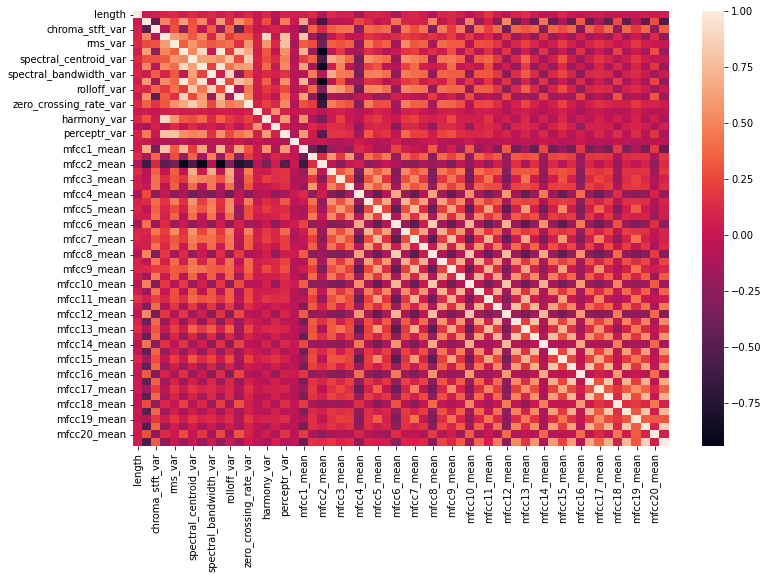

In [34]:
plt.figure(figsize = (12, 8))

corr_p = round(data.iloc[:, :-1].corr(), 3) # with linear relationship assumption

sns.heatmap(corr_p)

In [35]:
np.sum(np.abs(corr_p) > 0.7)

length                     1
chroma_stft_mean           1
chroma_stft_var            1
rms_mean                   4
rms_var                    2
spectral_centroid_mean     6
spectral_centroid_var      3
spectral_bandwidth_mean    4
spectral_bandwidth_var     2
rolloff_mean               6
rolloff_var                3
zero_crossing_rate_mean    4
zero_crossing_rate_var     2
harmony_mean               1
harmony_var                2
perceptr_mean              1
perceptr_var               3
tempo                      1
mfcc1_mean                 4
mfcc1_var                  1
mfcc2_mean                 5
mfcc2_var                  1
mfcc3_mean                 1
mfcc3_var                  1
mfcc4_mean                 1
mfcc4_var                  2
mfcc5_mean                 2
mfcc5_var                  1
mfcc6_mean                 4
mfcc6_var                  2
mfcc7_mean                 4
mfcc7_var                  1
mfcc8_mean                 4
mfcc8_var                  2
mfcc9_mean    

In [36]:
from statsmodels.stats.outliers_influence import variance_inflation_factor 
   
  
vif_data = pd.DataFrame() 
vif_data["feature"] = data.columns[:-1] 
  
vif_data["VIF"] = [variance_inflation_factor(data.iloc[:, :-1].values, i) 
                          for i in range(len(data.columns[:-1]))] 
  
print(vif_data)

                    feature          VIF
0                    length  4058.654865
1          chroma_stft_mean   179.985434
2           chroma_stft_var   482.142444
3                  rms_mean   366.349568
4                   rms_var     9.399107
5    spectral_centroid_mean  3277.156568
6     spectral_centroid_var    87.240138
7   spectral_bandwidth_mean  1913.842349
8    spectral_bandwidth_var    23.872207
9              rolloff_mean  1609.872017
10              rolloff_var    59.992623
11  zero_crossing_rate_mean   309.658301
12   zero_crossing_rate_var    27.800510
13             harmony_mean     1.677546
14              harmony_var    44.263613
15            perceptr_mean     1.970017
16             perceptr_var    22.488109
17                    tempo    20.611988
18               mfcc1_mean    96.308455
19                mfcc1_var     6.592192
20               mfcc2_mean   287.660981
21                mfcc2_var    18.191820
22               mfcc3_mean     7.967365
23              

### Mean

In [37]:
grouped_data.mean()

,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,...,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
label,,,,,,,,,,,,,,,,,,,,,
blues,661794.00,0.341429,0.090700,0.136067,0.003015,1727.584661,289738.903099,1931.447105,113632.662376,3636.877154,...,0.193491,64.327187,-7.217955,64.982897,-1.448949,67.494990,-3.606209,68.857226,-2.793275,70.309525
classical,662116.10,0.263542,0.085117,0.042920,0.000706,1353.878837,123433.708255,1521.709862,82450.128596,2482.325982,...,1.044787,76.558489,0.176529,77.055251,0.571998,80.744419,-1.065244,94.390691,-1.066748,114.119585
country,662027.76,0.343812,0.086471,0.125988,0.001726,1896.210622,375603.751882,2099.535390,145431.565441,3949.577166,...,-0.388173,58.811919,-5.618285,61.268125,-0.365908,59.394237,-2.816718,56.763077,-3.055206,61.019813
disco,661934.80,0.415643,0.084668,0.136296,0.002895,2619.852229,498543.826654,2513.251591,133819.522275,5519.791820,...,1.243687,51.066385,-4.326491,53.473215,1.130248,56.773737,-2.960387,59.002601,0.480941,60.454717
hiphop,663468.24,0.454319,0.088285,0.178344,0.007279,2524.518523,769122.746369,2513.452483,174018.893731,5333.623851,...,2.596768,56.658187,-2.960372,60.599478,1.384509,58.212162,-1.739940,59.759810,-0.806001,62.580393
jazz,662233.28,0.296643,0.089909,0.086648,0.001455,1792.360097,271372.514673,2021.001244,110450.414117,3750.174280,...,0.487133,81.236784,-1.453946,80.678183,-0.955960,83.478559,-1.144374,90.736064,-2.088557,101.477950
metal,661596.80,0.479235,0.074208,0.153478,0.001308,2602.181204,216061.696329,2242.538687,68989.534738,5125.230255,...,5.450559,39.008028,-7.969246,40.202777,2.885922,38.940272,-4.740642,38.016470,1.264175,34.358525
pop,661504.00,0.397632,0.089429,0.199734,0.007292,3073.549538,957036.816712,3008.195592,183446.721734,6654.772975,...,-0.972551,74.938113,-0.375791,78.074702,0.526494,83.124934,0.847990,84.657185,0.307300,84.295304
reggae,661622.90,0.408247,0.090597,0.122503,0.003132,2185.016755,772150.822191,2311.453709,222063.366304,4593.939352,...,0.976151,59.484003,-3.641866,61.487863,1.054487,57.929388,-2.160267,59.887746,-1.607359,62.892397


### Standard Deviation

In [38]:
grouped_data.std()

,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,...,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
label,,,,,,,,,,,,,,,,,,,,,
blues,0.000000,0.058422,0.006642,0.051978,0.001893,515.526151,176827.251237,330.214368,76921.300822,1160.651549,...,6.480287,27.618867,4.084105,28.374032,4.443170,33.350787,4.648279,30.158339,5.299195,30.997254
classical,1583.648195,0.044096,0.003192,0.036830,0.000851,348.164268,101367.840885,254.236037,77132.543459,751.014031,...,4.331590,34.625750,4.187054,34.390636,3.856687,39.544805,3.471303,49.566112,3.820228,64.496361
country,1189.911745,0.040923,0.004489,0.049196,0.000935,575.912832,203469.702897,445.278799,65366.900573,1293.225995,...,4.656351,19.127166,3.494105,21.353239,4.303461,25.195609,3.153193,20.796994,3.322862,27.279885
disco,1257.321058,0.047113,0.006007,0.043304,0.002057,478.806962,246106.335474,357.496881,86519.942136,1039.784877,...,3.679722,18.753370,4.029805,21.136649,3.529752,22.961249,3.379468,20.800663,3.188322,22.114996
hiphop,4380.745071,0.047097,0.007416,0.059893,0.006046,479.286475,448914.318787,347.197818,114501.183068,1004.949516,...,4.195870,19.994008,2.841137,24.986833,4.072919,26.226922,3.468336,31.164201,3.605825,33.171445
jazz,1696.357369,0.054470,0.004880,0.045733,0.001324,680.641159,264626.423321,567.440784,65791.786076,1556.103437,...,4.465476,60.272867,3.782823,54.785373,3.169192,47.792641,3.397880,54.839355,3.577407,71.490543
metal,135.959590,0.051745,0.008445,0.064175,0.001303,368.566462,121224.896578,201.325887,43708.133250,632.035185,...,3.172143,13.598705,2.774385,19.388048,2.905122,15.583658,3.493641,13.749357,3.851246,10.904955
pop,0.000000,0.057094,0.005756,0.058004,0.004847,582.121261,420657.454919,316.946183,85354.029913,1224.026623,...,3.606330,48.093273,3.570188,41.132702,3.514286,41.520917,2.762064,38.512052,2.847948,39.238584
reggae,143.350210,0.059162,0.006948,0.050663,0.002772,626.596310,480564.155905,390.704772,103071.456693,1197.361024,...,3.668015,17.385946,3.789366,23.777139,3.449584,21.968241,2.766815,20.955102,3.068098,26.382694


### Median

In [39]:
grouped_data.median()

,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,...,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
label,,,,,,,,,,,,,,,,,,,,,
blues,661794,0.339091,0.091234,0.126420,0.002828,1630.675057,230569.037911,1973.591922,81664.989017,3565.139863,...,0.964488,58.251854,-6.691663,57.035189,-1.545343,57.656586,-3.701761,60.122570,-2.052564,61.665489
classical,661794,0.260931,0.084582,0.031869,0.000401,1344.958698,94167.083874,1520.016313,58036.134917,2475.106804,...,1.151493,65.027328,0.044875,68.644093,0.236766,69.615826,-1.286662,80.190079,-1.440786,102.255245
country,661794,0.347686,0.086153,0.114521,0.001567,1767.215525,332879.894850,2036.334309,134757.236657,3714.465049,...,0.385778,53.531366,-6.317081,54.458614,0.059130,51.325054,-3.195045,51.731230,-2.894463,54.653389
disco,661504,0.416673,0.084047,0.124458,0.002311,2545.413692,447309.502238,2431.888669,111967.713792,5362.816760,...,1.736935,45.539007,-4.387591,49.079155,1.392927,49.672228,-3.219711,56.633671,-0.044634,56.507700
hiphop,661794,0.452387,0.088786,0.182424,0.005476,2500.513459,689107.566014,2462.643244,138565.805272,5317.271227,...,2.269658,52.450447,-2.664338,56.169535,1.084392,53.280313,-2.144630,50.554417,-1.193096,54.366858
jazz,661794,0.285688,0.089835,0.078201,0.001231,1692.852898,192206.581401,2002.339787,98935.677207,3463.574340,...,0.307453,62.381420,-1.482041,66.918835,-1.196296,69.091755,-1.318198,76.796799,-2.036435,86.647923
metal,661504,0.477866,0.075219,0.137383,0.000982,2683.280387,189245.505763,2238.358972,57684.553941,5181.479045,...,5.560821,36.119253,-7.821586,35.950401,3.432788,35.892784,-4.955519,35.675507,1.407859,32.185753
pop,661504,0.402106,0.089467,0.203363,0.006543,3143.659060,926543.989340,3051.996053,163792.569445,6879.308827,...,-1.060454,61.289095,-0.683393,69.676575,0.725302,73.350479,0.783871,77.873482,0.298872,79.659401
reggae,661504,0.396217,0.091667,0.112306,0.002193,2069.971846,655201.576376,2245.954861,211171.317955,4444.462285,...,0.863523,58.201338,-4.110489,55.072599,0.916004,54.242321,-2.034116,57.252825,-1.350421,59.464264


### Minimum

In [40]:
grouped_data.min()

,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,...,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
label,,,,,,,,,,,,,,,,,,,,,
blues,661794,0.233398,0.075722,0.051400,0.000325,570.040355,89815.187631,995.716054,24997.757809,927.651390,...,-15.693844,24.135128,-17.234728,28.894934,-11.713449,26.164177,-18.501955,31.848198,-19.929634,28.149181
classical,661344,0.181137,0.078476,0.005276,0.000004,690.200858,7911.251394,898.066208,15804.932551,749.140636,...,-10.897033,14.534595,-9.870931,13.931521,-8.505704,15.662603,-9.148158,20.659353,-8.062643,23.679209
country,661100,0.221440,0.073870,0.022782,0.000259,857.638582,93537.474875,1195.504133,40987.078803,1443.765464,...,-11.290634,26.375435,-11.337584,27.640854,-10.540270,26.237810,-10.407794,28.755402,-10.711282,29.562561
disco,661344,0.220175,0.070011,0.047007,0.000536,1710.869314,129659.586836,1620.191204,43228.108244,3238.890185,...,-7.851331,23.114311,-14.491743,26.995438,-9.157988,25.344149,-10.708814,25.110504,-5.977642,24.809027
hiphop,660000,0.340300,0.066410,0.039177,0.000649,1470.311629,162243.481735,1688.321317,28884.996719,3093.278769,...,-6.082985,19.906462,-12.052432,20.363089,-5.529989,16.564707,-9.282306,15.415490,-7.355111,16.642084
jazz,661676,0.171939,0.080001,0.021187,0.000150,749.353904,45844.412124,1037.695356,17744.089480,1133.549114,...,-11.205058,17.922062,-12.292102,19.612217,-8.568900,20.133987,-9.928867,16.212904,-10.596965,18.466488
metal,661504,0.341908,0.044555,0.040851,0.000079,1443.331413,43747.335286,1583.767425,14180.686902,3285.628727,...,-5.860574,17.186430,-13.954101,18.154377,-7.770836,15.420555,-11.754225,18.852900,-9.290500,16.540594
pop,661504,0.225680,0.073596,0.037566,0.000273,1826.475341,261307.494531,2066.669705,63534.430332,3670.803274,...,-13.839117,22.247259,-10.180495,23.468571,-11.963694,28.696745,-6.142716,25.661821,-6.399621,22.277958
reggae,661504,0.271977,0.048071,0.025826,0.000342,1052.209329,114514.725156,1401.078377,30949.779045,2055.438332,...,-7.491716,9.169314,-13.639559,15.007277,-7.991913,18.109871,-9.144039,13.487622,-12.712146,7.956583


### Maximum

In [41]:
grouped_data.max()

,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,...,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
label,,,,,,,,,,,,,,,,,,,,,
blues,661794,0.466529,0.108111,0.270942,0.009200,2840.060761,1.030482e+06,2531.268049,335261.334729,5770.931745,...,13.016836,194.223755,1.325362,158.519836,8.941849,220.354065,7.541378,176.933533,6.646699,175.964890
classical,672282,0.437906,0.095229,0.189830,0.004038,2423.299494,5.489326e+05,2435.920257,577986.085690,4993.538147,...,11.606802,163.772018,11.280721,201.510773,15.388390,224.231369,14.694924,291.526215,11.523016,457.233368
country,669680,0.437655,0.098811,0.274516,0.004943,3760.290664,1.279413e+06,3052.840652,331767.009172,7441.953272,...,7.857594,119.051506,3.075905,134.923615,7.538697,158.923920,6.230408,165.977478,6.310607,215.641235
disco,668140,0.568171,0.104011,0.294004,0.012267,3715.271351,1.492491e+06,3398.440463,558104.260490,8074.801289,...,9.851818,129.864731,4.046981,143.826569,8.014792,155.201614,4.695799,125.510223,10.207119,136.007401
hiphop,675808,0.583706,0.103348,0.300407,0.027679,3785.403949,2.099148e+06,3321.430743,592713.065641,7642.430224,...,12.851307,118.155540,1.736788,175.929169,12.991805,181.693222,14.656418,202.773300,15.369627,225.773956
jazz,672100,0.441749,0.103829,0.231890,0.008205,4135.664564,1.905302e+06,3328.972307,342129.725183,8257.125734,...,13.457150,392.932373,9.403632,406.058868,6.919148,332.905426,7.883079,393.161987,9.826226,506.065155
metal,661794,0.636210,0.090784,0.312847,0.006987,3403.073174,8.525888e+05,2825.134867,283181.618209,6903.007008,...,12.421032,86.681244,-0.342663,109.469666,8.430045,101.827110,4.240802,85.032974,9.080583,64.298378
pop,661504,0.522806,0.101076,0.397973,0.021620,4225.533439,2.602665e+06,3509.646417,493993.006663,8677.672688,...,11.363940,386.652893,11.482946,232.677200,14.184083,263.308533,9.181066,278.392303,8.227995,258.050903
reggae,661794,0.663685,0.104077,0.351055,0.014570,4435.243901,3.036843e+06,3361.799184,537337.420813,8249.731502,...,12.580997,106.523758,4.474810,135.273865,12.441627,140.919281,4.745884,119.053421,5.303598,177.675522


### Principal component analysis

In [69]:
from sklearn.decomposition import PCA # As we only have numerical features ;

In [70]:
scaler = StandardScaler(with_mean = True, with_std = True)

data_scaled = scaler.fit_transform(data.iloc[:, data.columns != 'label'])

In [71]:
data_scaled = pd.DataFrame(data = data_scaled, columns = data.columns[data.columns != 'label'].values)

In [72]:
data_scaled

,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,...,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
0,-0.132822,-0.350137,0.312587,-0.010690,-0.061856,-0.583585,-0.848311,-0.456402,-0.531042,-0.486473,...,-0.086396,-0.246114,0.500462,-0.780265,-0.237040,-0.643177,0.006723,-0.300597,0.604064,-0.512988
1,-0.132822,-0.462482,1.117572,-0.532852,-0.186821,-0.938516,-0.234194,-0.386852,0.796252,-0.648681,...,-0.048102,-0.159175,0.711371,-0.069304,-0.054982,-0.453456,0.544806,-0.407087,0.424127,-0.538421
2,-0.132822,-0.184225,-0.137701,0.679978,-0.084093,-0.906885,-0.781694,-0.940663,-0.630916,-0.971592,...,0.284825,-0.596243,-0.827516,-0.448091,-0.600983,-0.329519,-0.295934,-0.527297,-0.296189,-0.874954
3,-0.132822,0.319639,0.990659,0.154810,0.907029,-1.581429,-0.712095,-1.228256,0.304565,-1.516390,...,-0.080249,-0.482843,0.142153,-0.371370,0.033427,-0.767591,0.455409,-0.779744,-0.602881,-0.844508
4,-0.132822,-0.859077,0.194163,-0.600165,-0.205909,-0.512542,-0.315178,-0.939770,-0.504463,-0.630107,...,-1.238616,0.751318,-0.327220,0.377620,-0.368375,-0.293696,-0.553016,-0.089383,-2.766009,-0.330287
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,-0.132822,-0.325957,-0.757009,-0.783606,-0.744969,-0.270585,-0.467974,-0.258529,-0.502756,-0.202028,...,0.140217,-0.464398,-2.050383,-0.623944,0.511084,-0.783303,-1.167931,-0.305875,-0.025668,-0.446301
996,-0.132822,0.244975,-1.455644,-0.829723,-0.678065,-0.272410,-0.717688,-0.330003,-0.566898,-0.268240,...,0.566107,-0.796066,-1.513447,-0.694466,0.355178,-0.921994,-1.367241,-0.727623,-0.443273,-0.848395
997,-0.132822,0.654637,-1.431989,-0.750625,-0.751249,-0.173636,-0.594046,-0.599270,-0.646859,-0.343166,...,0.150753,-0.803610,-1.952593,-0.784951,0.758508,-0.805923,-2.732844,-0.638651,-0.263615,-0.890605
998,-0.132822,-0.198339,0.668144,-0.716978,-0.506618,-1.122245,-0.572432,-0.806175,-0.290319,-0.988510,...,-0.865330,-0.426656,-0.098962,-0.569286,0.271131,-0.854487,-0.722717,-0.511485,-0.650649,-0.637683


In [73]:
pca_model = PCA(n_components = 0.90, svd_solver = 'full')

pca_model.fit(data_scaled)

PCA(n_components=0.9, svd_solver='full')

In [74]:
coord_fact = pca_model.transform(data_scaled)

coord_fact.shape

(1000, 24)

Text(0, 0.5, 'variance %')

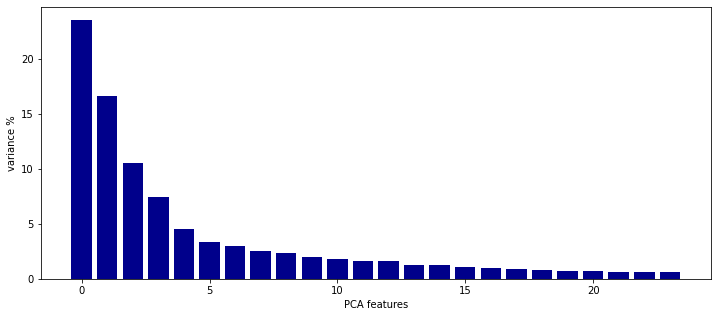

In [75]:
# Plot the explained variances
plt.figure(figsize = (12, 5))
features = range(pca_model.n_components_)

plt.bar(features, pca_model.explained_variance_ratio_ * 100, color = 'darkblue')
plt.xlabel('PCA features')
plt.ylabel('variance %')

In [76]:
print(f" The % of the total variance explained by the firsts {pca_model.n_components_} components is of {round(sum(pca_model.explained_variance_ratio_), 3) * 100} %.")

 The % of the total variance explained by the firsts 24 components is of 90.5 %.


#### Display 3D (just for vizualisation)

In [50]:
# https://github.com/wiqaaas/youtube/blob/master/Data_Visualization_using_Python/Data%20Visualization%20Capstone.ipynb

In [51]:
import seaborn as sns
import matplotlib.patches as mpatches # needed for waffle Charts
from plotly.offline import plot, iplot, init_notebook_mode
import plotly.graph_objs as go

init_notebook_mode (connected = True)
from IPython.display import display

In [52]:
pca_label = pd.concat([pd.DataFrame(coord_fact[:, 1:4]),pd.DataFrame(data.label)],axis=1)

In [53]:
pca_label.columns = ['1rst PC', '2th PC', '3th PC', 'Label']

pca_label

,1rst PC,2th PC,3th PC,Label
0,-1.021673,-0.523478,-0.115988,blues
1,-1.178053,1.349842,-2.460841,blues
2,-1.562924,-0.090188,-1.597133,blues
3,-1.485133,-1.524418,-1.898587,blues
4,-3.206651,0.136129,-2.214041,blues
...,...,...,...,...
995,-1.524550,0.630490,-1.190875,rock
996,-1.375977,-0.203681,-1.008859,rock
997,-1.278267,0.439746,-1.663879,rock
998,-1.968865,-0.360004,-2.831152,rock


In [54]:
fig = px.scatter_3d(pca_label, x = '1rst PC', y = '2th PC',
                    z = '3th PC',
                    color = 'Label')
fig.show()

In [55]:
print (f" % of the total variance explained by the first three components {round(sum(pca_model.explained_variance_ratio_[1:4]), 4) * 100} %.")

 % of the total variance explained by the first three components 34.69 %.


#### Feature Extraction

In [56]:
# PCA case (we test both cases)

pca_data = pd.concat([pd.DataFrame(coord_fact),pd.DataFrame(data.label)], axis=1)

In [57]:
columns = ['PCA1', 'PCA2', 'PCA3', 'PCA4', 'PCA5', 'PCA6', 'PCA7', 'PCA8', 'PCA9',
           'PCA10', 'PCA11', 'PCA12', 'PCA13', 'PCA14', 'PCA15', 'PCA16', 'PCA17', 'PCA18',
           'PCA19', 'PCA20', 'PCA21', 'PCA22', 'PCA23', 'PCA24', 'label']


pca_data.columns = columns

In [58]:
pca_data.head(n = 10)

,PCA1,PCA2,PCA3,PCA4,PCA5,PCA6,PCA7,PCA8,PCA9,PCA10,...,PCA16,PCA17,PCA18,PCA19,PCA20,PCA21,PCA22,PCA23,PCA24,label
0,-2.789358,-1.021673,-0.523478,-0.115988,-0.714268,0.987122,0.342766,-0.432069,-0.174466,-0.287908,...,-0.566878,-0.379610,0.338821,-0.694117,-0.349759,-0.023174,-0.467917,-0.018207,-0.444874,blues
1,1.716939,-1.178053,1.349842,-2.460841,-2.059089,0.027975,0.060529,-0.266016,-1.040386,-1.509997,...,-0.269714,0.813557,-0.116493,-0.268989,-1.002590,-0.302291,-0.499538,-0.061330,-0.128054,blues
2,-2.821820,-1.562924,-0.090188,-1.597133,0.699041,1.721764,0.535140,-0.202608,0.513235,0.749509,...,-0.105680,0.032711,-0.017000,-0.074912,-0.218497,0.341016,0.013441,0.663634,-0.141003,blues
3,0.336500,-1.485133,-1.524418,-1.898587,-1.888028,2.345393,0.197997,-0.131728,-0.582080,-1.053356,...,-0.200650,0.450519,-0.240911,0.212333,-1.598982,0.391576,0.106558,0.433412,0.088976,blues
4,0.610026,-3.206651,0.136129,-2.214041,3.250134,-0.026959,1.492277,0.106352,1.252485,0.467915,...,0.461081,-0.312099,-0.147179,0.132724,-0.962034,-1.188471,-0.424498,0.725089,-1.067794,blues
5,4.171878,-0.644680,0.485834,-5.246192,1.723997,-1.194274,0.448761,-1.788634,2.284165,0.309355,...,1.041823,-2.401107,-1.031678,0.281800,-0.445859,-1.074837,0.781028,-0.412470,-0.673135,blues
6,5.600751,-1.602904,0.181681,-7.297666,1.378255,1.593336,0.956584,-1.343779,3.460370,-1.636049,...,-0.349308,-0.638191,0.114345,1.424124,-1.863700,-2.063335,-0.004654,-0.500357,0.453855,blues
7,4.026763,-2.668775,0.472055,-5.803570,2.315295,1.328746,1.537301,0.974679,0.661630,-1.086758,...,0.903217,-1.287208,-0.349437,0.741807,-1.207699,-0.841113,-0.727632,-0.345775,0.077192,blues
8,-3.391248,-0.755362,-0.030511,-0.986693,-0.991906,1.079329,-0.119524,-1.058236,-0.382461,-0.833189,...,-0.182073,-0.190481,0.043415,0.317902,0.042184,-1.143092,-0.556727,1.281571,-0.759041,blues
9,2.732994,-2.289516,0.637016,-1.504154,-0.089145,0.347602,0.654490,-0.926910,1.198566,-1.687703,...,-0.598541,-0.889963,-0.294935,-0.206747,-1.066475,-2.049159,-0.150881,0.160271,-1.598799,blues


### Preprocessing and Mutual Information Analysis

In [27]:
labels = data.iloc[:, -1]

encoder = LabelEncoder()
target_encoded = pd.Series(encoder.fit_transform(labels), index = np.arange(0, 1000))

X = StandardScaler().fit_transform(np.array(data.iloc[:, :-1], dtype = np.float64))

X = pd.DataFrame(X, columns = data.columns[:-1])

In [28]:
X_train, X_test, y_train, y_test = train_test_split(X,
                                                    target_encoded,
                                                    test_size = 0.15,
                                                    stratify = target_encoded,
                                                    random_state = 42)

In [29]:
X_train.index = np.arange(0, len(X_train))
X_test.index = np.arange(0, len(X_test))
y_train.index = np.arange(0, len(y_train))
y_test.index = np.arange(0, len(y_test))

In [30]:
mut_inf = mutual_info_classif(X_train,
                              y_train,
                              discrete_features = 'auto') #, n_jobs=-1)

mi_scores = pd.Series(mut_inf,
                      index = X_train.columns)

mi_scores = mi_scores.sort_values(ascending = False)

print(mi_scores[:10]) # top 5

chroma_stft_mean           0.534827
perceptr_var               0.510651
spectral_bandwidth_mean    0.457280
rolloff_mean               0.451118
spectral_centroid_var      0.402589
spectral_centroid_mean     0.399233
rms_var                    0.387327
mfcc1_mean                 0.383471
zero_crossing_rate_var     0.365451
length                     0.356359
dtype: float64


In [31]:
features = 58 #change here to take less points
best_features = mi_scores.iloc[range(0, features)]
indexes = best_features.index

In [32]:
X_mi_train = X_train.copy()
X_mi_train = X_mi_train.loc[: , indexes]

X_mi_test = X_test.copy()
X_mi_test = X_mi_test.loc[: , indexes]

In [33]:
X_mi_train

,chroma_stft_mean,perceptr_var,spectral_bandwidth_mean,rolloff_mean,spectral_centroid_var,spectral_centroid_mean,rms_var,mfcc1_mean,zero_crossing_rate_var,length,...,mfcc12_var,mfcc18_var,mfcc14_var,mfcc15_var,mfcc19_var,mfcc16_mean,mfcc9_var,mfcc20_mean,mfcc18_mean,mfcc19_mean
0,0.443646,0.114217,1.072486,0.551121,0.554114,0.224173,-0.258334,0.975511,-0.472589,-0.132822,...,-0.574612,-0.901341,-0.585858,-0.689935,-0.770891,-0.269591,-0.759067,-0.638467,0.007673,1.291347
1,1.252986,-0.184972,0.009698,0.492219,-0.818372,0.821120,-0.770521,1.162130,-0.551546,-0.295453,...,-1.254116,-1.096071,-0.973276,-1.007860,-1.063162,1.292668,-1.403752,0.971230,2.048617,-0.320390
2,0.416971,1.057611,1.515030,1.213097,1.741135,0.896534,0.676455,0.727708,1.459933,-0.295453,...,0.214709,1.223027,0.625318,-0.182044,0.962468,0.168865,0.966529,0.958860,1.419763,2.244624
3,1.014460,0.239183,-0.040202,0.287620,-0.849499,0.360142,-0.554665,1.287181,-0.604240,-0.132822,...,-0.716201,-0.456587,-0.774636,-0.750043,-0.879982,0.579056,-0.957145,1.269635,1.632088,0.104724
4,1.737146,-0.004869,-0.546819,-0.821132,-0.285343,-1.022173,0.103064,-0.713634,-0.603696,-0.132822,...,-0.533203,-0.669237,-0.548496,-0.161579,-0.419638,-0.050456,0.234462,-0.761190,-0.589284,0.931455
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
845,0.908206,-0.421190,0.200730,0.296566,-0.100799,0.126459,-0.351600,-0.101125,-0.028173,-0.295453,...,-0.146921,0.055069,-0.589759,-0.494847,-0.043457,0.471091,-0.533930,0.494480,1.831397,0.793782
846,0.287657,0.095231,0.846905,0.702432,-0.085098,0.845540,-0.271245,1.089126,0.106623,-0.132822,...,-1.095455,-0.915274,-0.791114,-0.343701,-0.724172,-1.024933,-1.211831,0.070163,-0.777019,-0.437971
847,-0.820283,-0.559165,-0.264365,-0.709350,-0.542197,-0.769086,-0.501336,0.260375,-0.818901,-0.132822,...,0.437475,-0.054385,0.421606,0.299609,0.214955,0.190776,-1.077783,0.874087,0.942438,1.460791
848,0.296750,1.122379,0.269033,0.619068,-0.508014,0.624584,0.487207,1.035267,-0.009685,-0.295453,...,-0.676231,-0.541597,-0.836942,-0.814412,-0.727890,-0.428447,0.098193,1.410617,-0.448410,-1.431081


In [34]:
X_mi_test

,chroma_stft_mean,perceptr_var,spectral_bandwidth_mean,rolloff_mean,spectral_centroid_var,spectral_centroid_mean,rms_var,mfcc1_mean,zero_crossing_rate_var,length,...,mfcc12_var,mfcc18_var,mfcc14_var,mfcc15_var,mfcc19_var,mfcc16_mean,mfcc9_var,mfcc20_mean,mfcc18_mean,mfcc19_mean
0,-1.915368,-0.867655,-1.086097,-1.137059,-0.941849,-0.988483,-0.712009,-1.359628,-0.684849,-0.132822,...,1.885262,-0.328287,2.117768,1.686559,1.394897,-0.733062,-0.207210,-1.522694,-1.155640,-1.816530
1,1.509262,2.101551,-0.193741,0.354589,-0.810767,0.756996,-0.340799,1.708784,-0.464260,-0.295453,...,-0.525965,-0.790879,-0.612156,-0.717260,-0.804772,1.974867,-0.401764,-0.739715,-0.570130,-1.407777
2,-0.141067,0.683336,0.548855,0.761995,-0.491975,0.438346,0.337475,0.883377,-0.435576,-0.132822,...,0.066791,-0.285782,0.676959,-0.167214,0.039466,0.867199,-0.081348,-0.225830,1.385899,-0.366566
3,-0.184225,0.275132,-0.940663,-0.971592,-0.781694,-0.906885,-0.084093,0.536542,-0.654970,-0.132822,...,-0.128510,-0.329519,-0.204831,-0.775892,-0.527297,0.284825,-0.585672,-0.296189,-0.600983,-0.295934
4,0.644684,4.925784,1.721961,1.705152,2.131407,1.828600,3.817816,1.014671,2.700112,-0.295453,...,-0.172683,-0.096985,0.129857,-0.149291,0.280564,-0.882927,0.137552,0.788281,0.097831,1.236426
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,0.173028,1.394117,1.321545,0.892622,2.726440,0.686725,1.655697,0.234941,2.657511,7.726164,...,1.597209,0.330489,0.270317,0.230927,0.969236,-1.231455,2.598543,-1.632234,-0.487552,-0.199992
146,0.923737,-0.354156,-0.273834,-0.293649,-0.718415,-0.644293,-0.670716,0.327640,-0.764474,-0.295453,...,-0.620792,-0.352395,-0.687279,-0.664107,-0.002168,0.048982,-0.753141,0.776448,1.328404,1.023579
147,0.693336,-0.411553,1.051754,0.979545,-0.240581,0.821274,-0.546879,0.912568,-0.157293,-0.295453,...,-0.669645,-0.622223,-0.880444,-0.821099,-0.717825,-0.598860,-0.631968,1.304364,0.495505,1.690824
148,0.765657,0.211321,0.026559,0.465763,-0.712149,0.622090,-0.247323,0.977257,-0.472964,-0.295453,...,-0.486817,-0.508726,-0.481651,-0.286754,-0.024815,0.911216,1.004378,-0.526979,0.224269,-0.638906


In [35]:
y_train

0      3
1      6
2      7
3      9
4      4
      ..
845    3
846    9
847    9
848    3
849    2
Length: 850, dtype: int64

In [36]:
y_test

0      1
1      6
2      0
3      0
4      7
      ..
145    4
146    6
147    7
148    6
149    6
Length: 150, dtype: int64

Text(0, 0.5, 'mutual dependance %')

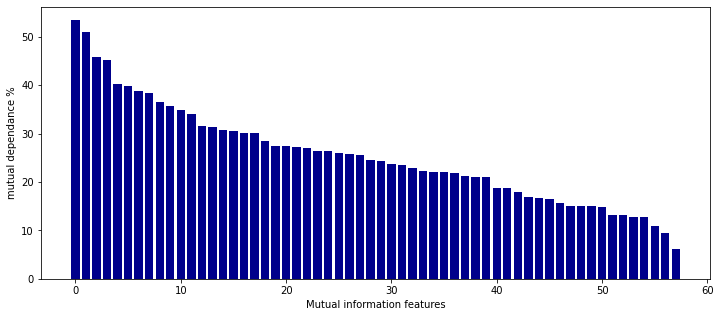

In [37]:
# Plot the explained variances

plt.figure(figsize = (12, 5))
features = range(len(mi_scores.values))

plt.bar(features, mi_scores.values * 100, color = 'darkblue')
plt.xlabel('Mutual information features')
plt.ylabel('mutual dependance %')

In [38]:
(X_train.shape, y_train.shape) # Training set but also validation set ; 

((850, 58), (850,))

In [39]:
(X_test.shape, y_test.shape) # Test set ;

((150, 58), (150,))

### PCA dataset

In [77]:
X_train_pca, X_test_pca, y_train_pca, y_test_pca = train_test_split(pca_data.iloc[:, :-1].values,
                                                                    target_encoded,
                                                                    test_size = 0.15,
                                                                    stratify = target_encoded,
                                                                    random_state = 42)

In [73]:
(X_train_pca.shape, y_train_pca.shape) # Training set but also validation set ; 

((850, 24), (850,))

In [74]:
(X_test_pca.shape, y_test_pca.shape) # Test set ;

((150, 24), (150,))

# Model Building

In [76]:
sKFold = RepeatedStratifiedKFold(n_splits = 5, n_repeats = 500, random_state = 42) 

## K Nearest Neighbors

### Original dataset

#### Traing and validation sets

In [77]:
kNN = KNeighborsClassifier()

In [78]:
param_grid = dict(n_neighbors = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10,
                                 15,  20, 25, 30, 35, 40, 45, 50,
                                 80, 100, 120, 150],
                 weights = ['uniform', 'distance'],
                 p = [1, 2]
                 )

In [79]:
grid_KNN = GridSearchCV(kNN,
                        param_grid,
                        n_jobs = -1,
                        cv = sKFold,
                        refit = True,
                        scoring = 'accuracy')

In [80]:
grid_KNN.fit(X_train, y_train)

GridSearchCV(cv=RepeatedStratifiedKFold(n_repeats=500, n_splits=5, random_state=42),
             estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid={'n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 20,
                                         25, 30, 35, 40, 45, 50, 80, 100, 120,
                                         150],
                         'p': [1, 2], 'weights': ['uniform', 'distance']},
             scoring='accuracy')

In [81]:
print (f"Optimal hyper parameters: {grid_KNN.best_params_}.")

Optimal hyper parameters: {'n_neighbors': 4, 'p': 1, 'weights': 'distance'}.


In [82]:
pd.DataFrame(grid_KNN.cv_results_)[1:20]

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_neighbors,param_p,param_weights,params,split0_test_score,split1_test_score,...,split2493_test_score,split2494_test_score,split2495_test_score,split2496_test_score,split2497_test_score,split2498_test_score,split2499_test_score,mean_test_score,std_test_score,rank_test_score
1,0.003813,0.001199,0.009565,0.001996,1,1,distance,"{'n_neighbors': 1, 'p': 1, 'weights': 'distance'}",0.729412,0.682353,...,0.741176,0.705882,0.670588,0.694118,0.635294,0.711765,0.747059,0.691875,0.031157,13
2,0.004137,0.002467,0.013277,0.004511,1,2,uniform,"{'n_neighbors': 1, 'p': 2, 'weights': 'uniform'}",0.676471,0.670588,...,0.682353,0.670588,0.600000,0.694118,0.641176,0.676471,0.717647,0.672525,0.030896,30
3,0.004181,0.001487,0.006184,0.002070,1,2,distance,"{'n_neighbors': 1, 'p': 2, 'weights': 'distance'}",0.676471,0.670588,...,0.682353,0.670588,0.600000,0.694118,0.641176,0.676471,0.717647,0.672525,0.030896,30
4,0.003632,0.001429,0.016688,0.003194,2,1,uniform,"{'n_neighbors': 2, 'p': 1, 'weights': 'uniform'}",0.682353,0.594118,...,0.623529,0.676471,0.588235,0.652941,0.611765,0.700000,0.717647,0.652873,0.030766,40
5,0.003801,0.001487,0.010037,0.002856,2,1,distance,"{'n_neighbors': 2, 'p': 1, 'weights': 'distance'}",0.729412,0.682353,...,0.741176,0.705882,0.670588,0.694118,0.635294,0.705882,0.758824,0.692722,0.031142,12
6,0.003794,0.001503,0.013062,0.002747,2,2,uniform,"{'n_neighbors': 2, 'p': 2, 'weights': 'uniform'}",0.652941,0.552941,...,0.611765,0.676471,0.570588,0.611765,0.611765,0.694118,0.700000,0.634784,0.030762,46
7,0.004028,0.000928,0.006333,0.001351,2,2,distance,"{'n_neighbors': 2, 'p': 2, 'weights': 'distance'}",0.676471,0.670588,...,0.682353,0.670588,0.600000,0.694118,0.641176,0.670588,0.717647,0.672913,0.030954,29
8,0.003436,0.000911,0.016315,0.002220,3,1,uniform,"{'n_neighbors': 3, 'p': 1, 'weights': 'uniform'}",0.735294,0.647059,...,0.670588,0.723529,0.641176,0.652941,0.641176,0.735294,0.735294,0.682628,0.030925,22
9,0.003618,0.000880,0.009813,0.001744,3,1,distance,"{'n_neighbors': 3, 'p': 1, 'weights': 'distance'}",0.752941,0.711765,...,0.729412,0.729412,0.694118,0.717647,0.670588,0.741176,0.776471,0.711035,0.030986,2
10,0.003717,0.001342,0.013331,0.002777,3,2,uniform,"{'n_neighbors': 3, 'p': 2, 'weights': 'uniform'}",0.658824,0.611765,...,0.647059,0.700000,0.617647,0.647059,0.647059,0.723529,0.694118,0.664504,0.030860,35


In [83]:
pd.DataFrame(pd.DataFrame(grid_KNN.cv_results_).loc[np.argmin(pd.DataFrame(grid_KNN.cv_results_)['rank_test_score'])]).T

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_neighbors,param_p,param_weights,params,split0_test_score,split1_test_score,...,split2493_test_score,split2494_test_score,split2495_test_score,split2496_test_score,split2497_test_score,split2498_test_score,split2499_test_score,mean_test_score,std_test_score,rank_test_score
13,0.003483,0.000923,0.01018,0.001215,4,1,distance,"{'n_neighbors': 4, 'p': 1, 'weights': 'distance'}",0.782353,0.705882,...,0.711765,0.747059,0.676471,0.723529,0.7,0.717647,0.741176,0.712744,0.031156,1


In [84]:
results = pd.DataFrame(grid_KNN.cv_results_)

uniform_1 = np.where((results['param_weights'] == 'uniform') & (results['param_p'] == 1))

uniform_2 = np.where((results['param_weights'] == 'uniform') & (results['param_p'] == 2))

distance_1 = np.where((results['param_weights'] == 'distance') & (results['param_p'] == 1))

distance_2 = np.where((results['param_weights'] == 'distance') & (results['param_p'] == 2))


validation_score_uniform_1 = results.loc[uniform_1, 'mean_test_score']
validation_score_uniform_2 = results.loc[uniform_2, 'mean_test_score']

validation_score_distance_1 = results.loc[distance_1, 'mean_test_score']
validation_score_distance_2 = results.loc[distance_2, 'mean_test_score']

In [85]:
n_neighbors = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 15,  20, 25, 30, 35, 40, 45, 50, 80, 100, 120, 150]

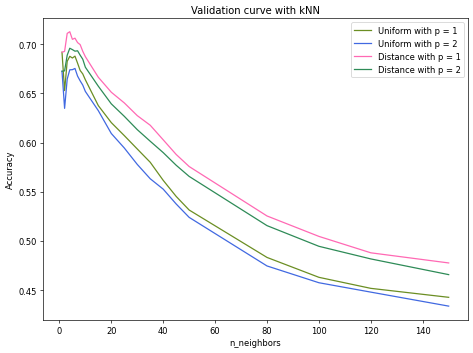

In [86]:
plt.figure(figsize = (8, 6), dpi= 60)

# Plot mean accuracy scores for training and test sets
plt.plot(n_neighbors, validation_score_uniform_1, label = "Uniform with p = 1", color = "olivedrab", alpha = 1)
plt.plot(n_neighbors, validation_score_uniform_2, label = "Uniform with p = 2", color = "royalblue", alpha = 1)
plt.plot(n_neighbors, validation_score_distance_1, label = "Distance with p = 1", color = "hotpink", alpha = 1)
plt.plot(n_neighbors, validation_score_distance_2, label = "Distance with p = 2", color = "seagreen", alpha = 1)


# Create plot
plt.title("Validation curve with kNN")
plt.xlabel("n_neighbors")
plt.ylabel("Accuracy")
plt.tight_layout()
plt.legend(loc = "best")
plt.show()

In [87]:
y_pred_class_train_set = grid_KNN.predict(X_train)

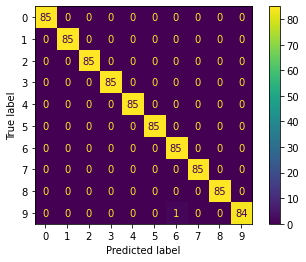

In [88]:
cm = confusion_matrix(y_train, y_pred_class_train_set,
                      labels = grid_KNN.classes_)

disp = ConfusionMatrixDisplay(confusion_matrix = cm,
                              display_labels = grid_KNN.classes_)
disp.plot()

In [89]:
print (f" Accuracy score onto our train set with our original model : {accuracy_score(y_train, y_pred_class_train_set ) * 100} %.")

 Accuracy score onto our train set with our original model : 99.88235294117646 %.


In [78]:
#time to fit/predict
model = KNeighborsClassifier(n_neighbors=4, p=1, weights='distance', n_jobs=-1)
start_fit = time.time()
model.fit(X_train, y_train)
interval_fit = time.time() - start_fit
print("fit time is:  "+str(interval_fit))

start_pred = time.time()
y_pred = model.predict(X_test)
interval = time.time() - start_pred
print("prediction time is:  "+str(interval))

fit time is:  0.002089977264404297
prediction time is:  0.012582778930664062


### PCA dataset

#### Training and validation set

In [90]:
kNN = KNeighborsClassifier()

In [91]:
grid_KNN_pca = GridSearchCV(kNN,
                        param_grid,
                        n_jobs = -1,
                        cv = sKFold,
                        refit = True,
                        scoring = 'accuracy')

In [92]:
grid_KNN_pca.fit(X_train_pca, y_train_pca)

GridSearchCV(cv=RepeatedStratifiedKFold(n_repeats=500, n_splits=5, random_state=42),
             estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid={'n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 20,
                                         25, 30, 35, 40, 45, 50, 80, 100, 120,
                                         150],
                         'p': [1, 2], 'weights': ['uniform', 'distance']},
             scoring='accuracy')

In [93]:
print (f"Optimal hyper parameters: {grid_KNN_pca.best_params_}.")

Optimal hyper parameters: {'n_neighbors': 7, 'p': 2, 'weights': 'distance'}.


In [94]:
pd.DataFrame(grid_KNN_pca.cv_results_)[10:30]

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_neighbors,param_p,param_weights,params,split0_test_score,split1_test_score,...,split2493_test_score,split2494_test_score,split2495_test_score,split2496_test_score,split2497_test_score,split2498_test_score,split2499_test_score,mean_test_score,std_test_score,rank_test_score
10,0.000948,0.000352,0.009968,0.001177,3,2,uniform,"{'n_neighbors': 3, 'p': 2, 'weights': 'uniform'}",0.664706,0.611765,...,0.664706,0.682353,0.594118,0.658824,0.629412,0.705882,0.694118,0.651369,0.030914,27
11,0.001194,0.000234,0.003556,0.000713,3,2,distance,"{'n_neighbors': 3, 'p': 2, 'weights': 'distance'}",0.717647,0.652941,...,0.700000,0.717647,0.582353,0.688235,0.647059,0.717647,0.717647,0.673751,0.031484,8
12,0.000913,0.000185,0.011273,0.001114,4,1,uniform,"{'n_neighbors': 4, 'p': 1, 'weights': 'uniform'}",0.670588,0.652941,...,0.658824,0.688235,0.600000,0.652941,0.635294,0.652941,0.711765,0.648395,0.032168,30
13,0.000977,0.000092,0.005200,0.000685,4,1,distance,"{'n_neighbors': 4, 'p': 1, 'weights': 'distance'}",0.670588,0.682353,...,0.682353,0.694118,0.600000,0.682353,0.664706,0.688235,0.747059,0.670426,0.032453,11
14,0.000947,0.000388,0.010565,0.001176,4,2,uniform,"{'n_neighbors': 4, 'p': 2, 'weights': 'uniform'}",0.700000,0.652941,...,0.670588,0.741176,0.629412,0.676471,0.652941,0.705882,0.700000,0.665212,0.031807,17
15,0.001130,0.000504,0.004125,0.000896,4,2,distance,"{'n_neighbors': 4, 'p': 2, 'weights': 'distance'}",0.723529,0.676471,...,0.664706,0.723529,0.623529,0.729412,0.658824,0.747059,0.711765,0.680965,0.031835,3
16,0.000917,0.000057,0.011608,0.001402,5,1,uniform,"{'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}",0.676471,0.652941,...,0.658824,0.694118,0.629412,0.688235,0.629412,0.658824,0.700000,0.650809,0.032228,28
17,0.000984,0.000081,0.005272,0.000969,5,1,distance,"{'n_neighbors': 5, 'p': 1, 'weights': 'distance'}",0.700000,0.700000,...,0.688235,0.723529,0.647059,0.711765,0.682353,0.670588,0.747059,0.675998,0.032211,6
18,0.000931,0.000146,0.010483,0.000906,5,2,uniform,"{'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}",0.694118,0.641176,...,0.658824,0.741176,0.635294,0.670588,0.664706,0.688235,0.723529,0.664974,0.032072,18
19,0.001135,0.000341,0.004171,0.000590,5,2,distance,"{'n_neighbors': 5, 'p': 2, 'weights': 'distance'}",0.723529,0.676471,...,0.670588,0.717647,0.647059,0.676471,0.676471,0.711765,0.741176,0.677099,0.031379,5


In [95]:
pd.DataFrame(pd.DataFrame(grid_KNN_pca.cv_results_).loc[np.argmin(pd.DataFrame(grid_KNN_pca.cv_results_)['rank_test_score'])]).T

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_neighbors,param_p,param_weights,params,split0_test_score,split1_test_score,...,split2493_test_score,split2494_test_score,split2495_test_score,split2496_test_score,split2497_test_score,split2498_test_score,split2499_test_score,mean_test_score,std_test_score,rank_test_score
27,0.001158,0.000457,0.004369,0.000966,7,2,distance,"{'n_neighbors': 7, 'p': 2, 'weights': 'distance'}",0.688235,0.682353,...,0.670588,0.747059,0.647059,0.682353,0.688235,0.717647,0.729412,0.683473,0.032064,1


In [96]:
results = pd.DataFrame(grid_KNN_pca.cv_results_)

uniform_1 = np.where((results['param_weights'] == 'uniform') & (results['param_p'] == 1))

uniform_2 = np.where((results['param_weights'] == 'uniform') & (results['param_p'] == 2))

distance_1 = np.where((results['param_weights'] == 'distance') & (results['param_p'] == 1))

distance_2 = np.where((results['param_weights'] == 'distance') & (results['param_p'] == 2))


validation_score_uniform_1 = results.loc[uniform_1, 'mean_test_score']
validation_score_uniform_2 = results.loc[uniform_2, 'mean_test_score']

validation_score_distance_1 = results.loc[distance_1, 'mean_test_score']
validation_score_distance_2 = results.loc[distance_2, 'mean_test_score']

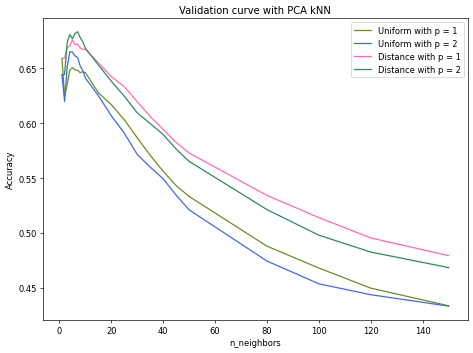

In [97]:
plt.figure(figsize = (8, 6), dpi= 60)

# Plot mean accuracy scores for training and test sets
plt.plot(n_neighbors, validation_score_uniform_1, label = "Uniform with p = 1", color = "olivedrab", alpha = 1)
plt.plot(n_neighbors, validation_score_uniform_2, label = "Uniform with p = 2", color = "royalblue", alpha = 1)
plt.plot(n_neighbors, validation_score_distance_1, label = "Distance with p = 1", color = "hotpink", alpha = 1)
plt.plot(n_neighbors, validation_score_distance_2, label = "Distance with p = 2", color = "seagreen", alpha = 1)


# Create plot
plt.title("Validation curve with PCA kNN")
plt.xlabel("n_neighbors")
plt.ylabel("Accuracy")
plt.tight_layout()
plt.legend(loc = "best")
plt.show()

In [98]:
y_pred_class_train_set_pca = grid_KNN_pca.predict(X_train_pca)

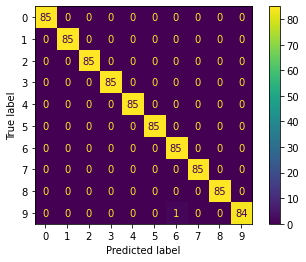

In [99]:
cm = confusion_matrix(y_train_pca, y_pred_class_train_set_pca,
                      labels = grid_KNN_pca.classes_)

disp = ConfusionMatrixDisplay(confusion_matrix = cm,
                              display_labels = grid_KNN_pca.classes_)
disp.plot()

In [100]:
print (f" Accuracy score onto our train set with our pca model : {accuracy_score(y_train_pca, y_pred_class_train_set_pca) * 100} %.")

 Accuracy score onto our train set with our pca model : 99.88235294117646 %.


In [79]:
#time to fit/predict
model = KNeighborsClassifier(n_neighbors=7, p=2, weights='distance', n_jobs=-1)
start_fit = time.time()
model.fit(X_train, y_train)
interval_fit = time.time() - start_fit
print("fit time is:  "+str(interval_fit))

start_pred = time.time()
y_pred = model.predict(X_test)
interval = time.time() - start_pred
print("prediction time is:  "+str(interval))

fit time is:  0.0021495819091796875
prediction time is:  0.012864112854003906


### Test set original data and pca dataset

In [101]:
y_pred_class_test_set = grid_KNN.predict(X_test)
y_pred_class_test_set_pca = grid_KNN_pca.predict(X_test_pca)

In [102]:
y_pred_class_test_set

array([1, 6, 2, 2, 7, 0, 0, 9, 5, 3, 7, 6, 5, 6, 8, 3, 2, 1, 9, 9, 0, 2,
       0, 8, 1, 0, 3, 8, 4, 7, 8, 4, 9, 1, 1, 8, 6, 9, 6, 9, 3, 1, 2, 5,
       1, 9, 9, 9, 5, 4, 2, 8, 6, 7, 4, 3, 3, 2, 1, 8, 7, 8, 4, 2, 7, 5,
       8, 9, 7, 2, 2, 8, 4, 6, 7, 7, 2, 2, 7, 5, 2, 8, 1, 9, 8, 8, 6, 8,
       5, 7, 7, 5, 0, 9, 4, 1, 2, 2, 7, 5, 9, 4, 2, 6, 2, 2, 1, 3, 1, 6,
       9, 8, 5, 5, 3, 3, 5, 9, 7, 3, 2, 7, 2, 4, 2, 7, 0, 0, 0, 2, 1, 6,
       0, 1, 6, 1, 2, 1, 9, 0, 7, 7, 9, 9, 5, 4, 0, 3, 9, 4])

In [103]:
y_pred_class_test_set_pca

array([1, 6, 2, 2, 7, 0, 0, 3, 5, 3, 7, 3, 5, 6, 1, 3, 8, 1, 9, 9, 9, 2,
       4, 8, 1, 0, 3, 8, 7, 7, 8, 4, 9, 1, 1, 8, 6, 9, 6, 9, 2, 1, 2, 5,
       1, 9, 2, 9, 5, 4, 2, 8, 3, 7, 4, 7, 3, 2, 1, 8, 7, 4, 4, 0, 7, 5,
       8, 9, 7, 8, 2, 8, 4, 6, 8, 7, 2, 2, 7, 5, 2, 4, 1, 9, 8, 8, 6, 4,
       9, 7, 3, 5, 0, 2, 8, 1, 2, 2, 7, 5, 9, 4, 0, 6, 8, 9, 1, 7, 1, 6,
       9, 8, 5, 5, 3, 8, 7, 6, 7, 3, 2, 8, 0, 4, 2, 7, 0, 0, 0, 2, 1, 6,
       0, 1, 6, 1, 2, 1, 9, 9, 7, 7, 9, 9, 5, 4, 6, 3, 9, 6])

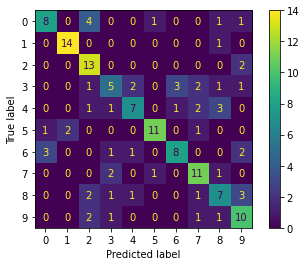

In [104]:
cm = confusion_matrix(y_test, y_pred_class_test_set,
                      labels = grid_KNN.classes_)

disp = ConfusionMatrixDisplay(confusion_matrix = cm,
                              display_labels = grid_KNN.classes_)
disp.plot()

In [105]:
print (f" Accuracy score onto our test set with our original model : {accuracy_score(y_test, y_pred_class_test_set) * 100} %.")

 Accuracy score onto our test set with our original model : 62.66666666666667 %.


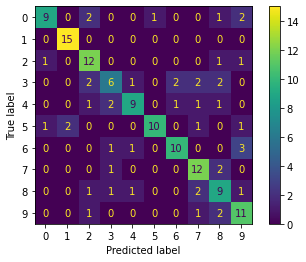

In [106]:
cm = confusion_matrix(y_test_pca, y_pred_class_test_set_pca,
                      labels = grid_KNN_pca.classes_)

disp = ConfusionMatrixDisplay(confusion_matrix = cm,
                              display_labels = grid_KNN_pca.classes_)
disp.plot()

In [107]:
print (f" Accuracy score onto our test set with our pca model : {accuracy_score(y_test_pca, y_pred_class_test_set_pca) * 100} %.")

 Accuracy score onto our test set with our pca model : 68.66666666666667 %.


## Multinomial Logistic regression

In [82]:
from sklearn.linear_model import LogisticRegression

In [109]:
multiLogistic = LogisticRegression(multi_class = 'multinomial',
                                   solver = 'saga',
                                   random_state = 42, n_jobs = -1,
                                   max_iter = 600)

### Original dataset

### Training and validation set

In [110]:
param_grid = dict(penalty = ['l1'],
                  C = np.linspace(0.1, 1.5, 15),
                  fit_intercept = [True, False])

In [111]:
grid_multiLogistic = GridSearchCV(multiLogistic,
                                 param_grid,
                                 scoring = 'accuracy',
                                 n_jobs = -1,
                                 cv = sKFold)

In [112]:
grid_multiLogistic.fit(X_train, y_train)

/home/aduer/venv4slr/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:328: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn("The max_iter was reached which means "
/home/aduer/venv4slr/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:328: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn("The max_iter was reached which means "
/home/aduer/venv4slr/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:328: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn("The max_iter was reached which means "
/home/aduer/venv4slr/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:328: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn("The max_iter was reached which means "
/home/aduer/venv4slr/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:328: ConvergenceWarning: The m

GridSearchCV(cv=RepeatedStratifiedKFold(n_repeats=500, n_splits=5, random_state=42),
             estimator=LogisticRegression(max_iter=600,
                                          multi_class='multinomial', n_jobs=-1,
                                          random_state=42, solver='saga'),
             n_jobs=-1,
             param_grid={'C': array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. , 1.1, 1.2, 1.3,
       1.4, 1.5]),
                         'fit_intercept': [True, False], 'penalty': ['l1']},
             scoring='accuracy')

In [113]:
print (f"Optimal hyper parameters: {grid_multiLogistic.best_params_}.")

Optimal hyper parameters: {'C': 0.7999999999999999, 'fit_intercept': True, 'penalty': 'l1'}.


In [114]:
pd.DataFrame(grid_multiLogistic.cv_results_)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_fit_intercept,param_penalty,params,split0_test_score,split1_test_score,...,split2493_test_score,split2494_test_score,split2495_test_score,split2496_test_score,split2497_test_score,split2498_test_score,split2499_test_score,mean_test_score,std_test_score,rank_test_score
0,1.507124,0.328474,0.002197,0.000397,0.1,True,l1,"{'C': 0.1, 'fit_intercept': True, 'penalty': '...",0.623529,0.664706,...,0.682353,0.647059,0.641176,0.617647,0.652941,0.647059,0.652941,0.642518,0.031405,29
1,1.420687,0.328470,0.002193,0.000329,0.1,False,l1,"{'C': 0.1, 'fit_intercept': False, 'penalty': ...",0.594118,0.629412,...,0.623529,0.658824,0.623529,0.588235,0.641176,0.588235,0.611765,0.614045,0.029649,30
2,2.462562,0.204906,0.002192,0.000390,0.2,True,l1,"{'C': 0.2, 'fit_intercept': True, 'penalty': '...",0.647059,0.717647,...,0.705882,0.711765,0.688235,0.682353,0.688235,0.700000,0.729412,0.699212,0.031672,27
3,2.257468,0.261696,0.002184,0.000262,0.2,False,l1,"{'C': 0.2, 'fit_intercept': False, 'penalty': ...",0.694118,0.676471,...,0.694118,0.700000,0.682353,0.682353,0.682353,0.682353,0.700000,0.686214,0.030887,28
4,2.631362,0.076518,0.002190,0.000259,0.3,True,l1,"{'C': 0.3, 'fit_intercept': True, 'penalty': '...",0.682353,0.729412,...,0.688235,0.729412,0.700000,0.700000,0.694118,0.705882,0.735294,0.713454,0.031571,22
5,2.565027,0.137634,0.002198,0.000465,0.3,False,l1,"{'C': 0.3, 'fit_intercept': False, 'penalty': ...",0.694118,0.700000,...,0.688235,0.717647,0.676471,0.682353,0.682353,0.688235,0.711765,0.703151,0.030990,26
6,2.661021,0.050054,0.002193,0.000298,0.4,True,l1,"{'C': 0.4, 'fit_intercept': True, 'penalty': '...",0.700000,0.735294,...,0.694118,0.741176,0.700000,0.705882,0.711765,0.717647,0.723529,0.719840,0.030965,12
7,2.618967,0.073055,0.002190,0.000282,0.4,False,l1,"{'C': 0.4, 'fit_intercept': False, 'penalty': ...",0.705882,0.723529,...,0.700000,0.729412,0.705882,0.688235,0.705882,0.682353,0.717647,0.709661,0.030916,25
8,2.679898,0.050340,0.002201,0.000387,0.5,True,l1,"{'C': 0.5, 'fit_intercept': True, 'penalty': '...",0.700000,0.747059,...,0.682353,0.741176,0.688235,0.711765,0.700000,0.723529,0.723529,0.723438,0.030973,8
9,2.643455,0.051810,0.002194,0.000354,0.5,False,l1,"{'C': 0.5, 'fit_intercept': False, 'penalty': ...",0.705882,0.717647,...,0.705882,0.717647,0.711765,0.700000,0.700000,0.682353,0.723529,0.713304,0.030943,23


In [115]:
pd.DataFrame(pd.DataFrame(grid_multiLogistic.cv_results_).loc[np.argmin(pd.DataFrame(grid_multiLogistic.cv_results_)['rank_test_score'])]).T

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_fit_intercept,param_penalty,params,split0_test_score,split1_test_score,...,split2493_test_score,split2494_test_score,split2495_test_score,split2496_test_score,split2497_test_score,split2498_test_score,split2499_test_score,mean_test_score,std_test_score,rank_test_score
14,2.724704,0.051138,0.00219,0.0002,0.8,True,l1,"{'C': 0.7999999999999999, 'fit_intercept': Tru...",0.7,0.741176,...,0.7,0.752941,0.694118,0.711765,0.723529,0.717647,0.758824,0.726042,0.030847,1


In [116]:
results = pd.DataFrame(grid_multiLogistic.cv_results_)

fit_true_intercept = np.where(results['param_fit_intercept'] == True)

fit_false_intercept = np.where(results['param_fit_intercept'] == False)


validation_score_fit_true = results.loc[fit_true_intercept, 'mean_test_score']
validation_score_fit_false = results.loc[fit_false_intercept, 'mean_test_score']

In [117]:
param_range = np.linspace(0.1, 1.5, 15)

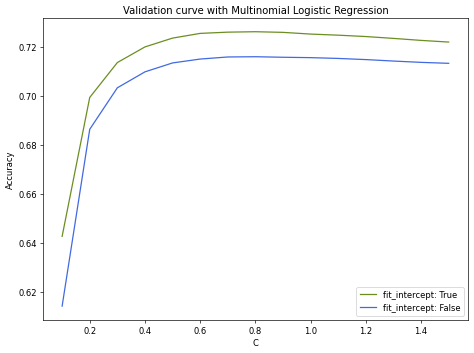

In [118]:
plt.figure(figsize = (8, 6), dpi= 60)

# Plot mean accuracy scores for training and test sets
plt.plot(param_range, validation_score_fit_true, label = "fit_intercept: True", color = "olivedrab", alpha = 1)
plt.plot(param_range, validation_score_fit_false, label = "fit_intercept: False", color = "royalblue", alpha = 1)


# Create plot
plt.title("Validation curve with Multinomial Logistic Regression")
plt.xlabel("C")
plt.ylabel("Accuracy")
plt.tight_layout()
plt.legend(loc = "best")
plt.show()

In [119]:
y_pred_class_train_set = grid_multiLogistic.predict(X_train)

In [120]:
print(f" Accuracy score onto our train set with our model : {accuracy_score(y_train, y_pred_class_train_set ) * 100} %.")

 Accuracy score onto our train set with our model : 87.41176470588236 %.


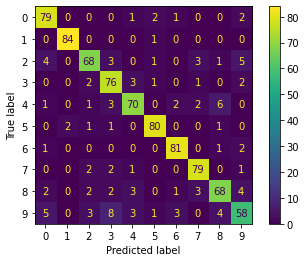

In [121]:
cm = confusion_matrix(y_train, y_pred_class_train_set,
                      labels = grid_multiLogistic.classes_)

disp = ConfusionMatrixDisplay(confusion_matrix = cm,
                              display_labels = grid_multiLogistic.classes_)
disp.plot()

In [83]:
#time to fit/predict
model = LogisticRegression(multi_class = 'multinomial',
                                   solver = 'saga',
                                   random_state = 42, n_jobs = -1,
                                   max_iter = 600, C=0.7999999999999999, fit_intercept=True, penalty='l1')
start_fit = time.time()
model.fit(X_train, y_train)
interval_fit = time.time() - start_fit
print("fit time is:  "+str(interval_fit))

start_pred = time.time()
y_pred = model.predict(X_test)
interval = time.time() - start_pred
print("prediction time is:  "+str(interval))

fit time is:  1.7858824729919434
prediction time is:  0.0015537738800048828


/home/aduer/venv4slr/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:328: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn("The max_iter was reached which means "


### PCA dataset

#### Training and validation set

In [122]:
grid_multiLogistic_pca = GridSearchCV(multiLogistic,
                                      param_grid,
                                      n_jobs = -1,
                                      cv = sKFold,
                                      refit = True,
                                      scoring = 'accuracy')

In [123]:
grid_multiLogistic_pca.fit(X_train_pca, y_train_pca)

/home/aduer/venv4slr/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:328: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn("The max_iter was reached which means "
/home/aduer/venv4slr/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:328: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn("The max_iter was reached which means "
/home/aduer/venv4slr/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:328: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn("The max_iter was reached which means "
/home/aduer/venv4slr/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:328: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn("The max_iter was reached which means "
/home/aduer/venv4slr/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:328: ConvergenceWarning: The m

GridSearchCV(cv=RepeatedStratifiedKFold(n_repeats=500, n_splits=5, random_state=42),
             estimator=LogisticRegression(max_iter=600,
                                          multi_class='multinomial', n_jobs=-1,
                                          random_state=42, solver='saga'),
             n_jobs=-1,
             param_grid={'C': array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. , 1.1, 1.2, 1.3,
       1.4, 1.5]),
                         'fit_intercept': [True, False], 'penalty': ['l1']},
             scoring='accuracy')

In [124]:
print (f"Optimal hyper parameters: {grid_multiLogistic_pca.best_params_}.")

Optimal hyper parameters: {'C': 0.7999999999999999, 'fit_intercept': True, 'penalty': 'l1'}.


In [125]:
pd.DataFrame(grid_multiLogistic_pca.cv_results_)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_fit_intercept,param_penalty,params,split0_test_score,split1_test_score,...,split2493_test_score,split2494_test_score,split2495_test_score,split2496_test_score,split2497_test_score,split2498_test_score,split2499_test_score,mean_test_score,std_test_score,rank_test_score
0,0.526093,0.055306,0.000506,0.000099,0.1,True,l1,"{'C': 0.1, 'fit_intercept': True, 'penalty': '...",0.611765,0.570588,...,0.588235,0.623529,0.576471,0.605882,0.617647,0.611765,0.629412,0.605515,0.031615,29
1,0.262733,0.028066,0.000516,0.000108,0.1,False,l1,"{'C': 0.1, 'fit_intercept': False, 'penalty': ...",0.594118,0.576471,...,0.564706,0.605882,0.552941,0.594118,0.594118,0.564706,0.594118,0.578631,0.029604,30
2,0.825297,0.102430,0.000497,0.000049,0.2,True,l1,"{'C': 0.2, 'fit_intercept': True, 'penalty': '...",0.670588,0.623529,...,0.641176,0.676471,0.658824,0.623529,0.670588,0.652941,0.711765,0.659096,0.030856,14
3,0.385980,0.044263,0.000510,0.000105,0.2,False,l1,"{'C': 0.2, 'fit_intercept': False, 'penalty': ...",0.664706,0.600000,...,0.635294,0.670588,0.611765,0.641176,0.658824,0.605882,0.682353,0.635285,0.030899,28
4,1.047634,0.125318,0.000500,0.000108,0.3,True,l1,"{'C': 0.3, 'fit_intercept': True, 'penalty': '...",0.676471,0.629412,...,0.658824,0.688235,0.688235,0.652941,0.664706,0.664706,0.717647,0.670038,0.030913,13
5,0.558653,0.084770,0.000504,0.000055,0.3,False,l1,"{'C': 0.3, 'fit_intercept': False, 'penalty': ...",0.670588,0.588235,...,0.658824,0.658824,0.647059,0.641176,0.652941,0.647059,0.688235,0.647812,0.030967,27
6,1.186863,0.082053,0.000505,0.000324,0.4,True,l1,"{'C': 0.4, 'fit_intercept': True, 'penalty': '...",0.682353,0.623529,...,0.664706,0.682353,0.688235,0.682353,0.676471,0.658824,0.717647,0.673704,0.031201,12
7,0.734250,0.120387,0.000499,0.000049,0.4,False,l1,"{'C': 0.4, 'fit_intercept': False, 'penalty': ...",0.658824,0.594118,...,0.676471,0.664706,0.652941,0.652941,0.670588,0.629412,0.700000,0.651953,0.030892,26
8,1.235516,0.044801,0.000502,0.000049,0.5,True,l1,"{'C': 0.5, 'fit_intercept': True, 'penalty': '...",0.700000,0.617647,...,0.670588,0.688235,0.694118,0.676471,0.688235,0.652941,0.723529,0.675988,0.031285,9
9,0.854984,0.130078,0.000500,0.000064,0.5,False,l1,"{'C': 0.5, 'fit_intercept': False, 'penalty': ...",0.652941,0.588235,...,0.682353,0.664706,0.647059,0.658824,0.664706,0.629412,0.688235,0.653802,0.030741,25


In [126]:
results = pd.DataFrame(grid_multiLogistic_pca.cv_results_)

fit_true_intercept = np.where(results['param_fit_intercept'] == True)

fit_false_intercept = np.where(results['param_fit_intercept'] == False)


validation_score_fit_true = results.loc[fit_true_intercept, 'mean_test_score']
validation_score_fit_false = results.loc[fit_false_intercept, 'mean_test_score']

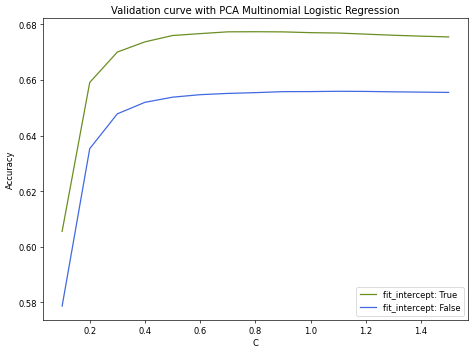

In [127]:
plt.figure(figsize = (8, 6), dpi= 60)

# Plot mean accuracy scores for training and test sets
plt.plot(param_range, validation_score_fit_true, label = "fit_intercept: True", color = "olivedrab", alpha = 1)
plt.plot(param_range, validation_score_fit_false, label = "fit_intercept: False", color = "royalblue", alpha = 1)


# Create plot
plt.title("Validation curve with PCA Multinomial Logistic Regression")
plt.xlabel("C")
plt.ylabel("Accuracy")
plt.tight_layout()
plt.legend(loc = "best")
plt.show()

In [128]:
y_pred_class_train_set_pca = grid_multiLogistic_pca.predict(X_train_pca)

In [129]:
print(f" Accuracy score onto our train set with our pca model : {accuracy_score(y_train_pca, y_pred_class_train_set_pca ) * 100} %.")

 Accuracy score onto our train set with our pca model : 76.70588235294117 %.


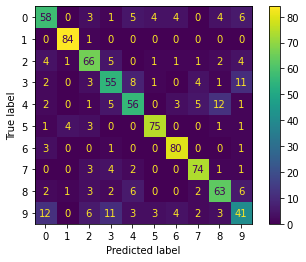

In [130]:
cm = confusion_matrix(y_train_pca, y_pred_class_train_set_pca,
                      labels = grid_multiLogistic_pca.classes_)

disp = ConfusionMatrixDisplay(confusion_matrix = cm,
                              display_labels = grid_multiLogistic_pca.classes_)
disp.plot()

In [84]:
#time to fit/predict
model = LogisticRegression(multi_class = 'multinomial',
                                   solver = 'saga',
                                   random_state = 42, n_jobs = -1,
                                   max_iter = 600, C=0.7999999999999999, fit_intercept=True, penalty='l1')

start_fit = time.time()
model.fit(X_train, y_train)
interval_fit = time.time() - start_fit
print("fit time is:  "+str(interval_fit))

start_pred = time.time()
y_pred = model.predict(X_test)
interval = time.time() - start_pred
print("prediction time is:  "+str(interval))

fit time is:  1.7840592861175537
prediction time is:  0.0015277862548828125


/home/aduer/venv4slr/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:328: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn("The max_iter was reached which means "


### Test set original data and pca dataset

In [131]:
y_pred_class_test_set = grid_multiLogistic.predict(X_test)
y_pred_class_test_set_pca = grid_multiLogistic_pca.predict(X_test_pca)

In [132]:
y_pred_class_test_set

array([1, 6, 0, 0, 7, 5, 5, 8, 5, 3, 7, 4, 5, 6, 1, 3, 8, 1, 9, 9, 0, 8,
       0, 8, 1, 6, 3, 8, 7, 4, 8, 4, 9, 0, 1, 8, 4, 9, 6, 9, 3, 1, 2, 5,
       1, 6, 9, 9, 5, 8, 2, 7, 3, 7, 4, 2, 3, 7, 1, 8, 7, 8, 0, 0, 7, 5,
       4, 2, 7, 8, 2, 9, 4, 6, 9, 7, 3, 3, 5, 5, 2, 8, 1, 6, 8, 8, 6, 8,
       5, 7, 8, 5, 0, 9, 8, 1, 2, 0, 7, 5, 9, 4, 0, 6, 2, 9, 1, 7, 1, 4,
       2, 8, 5, 5, 3, 9, 7, 9, 7, 4, 2, 8, 2, 0, 2, 7, 0, 5, 0, 2, 1, 6,
       0, 1, 6, 1, 2, 1, 8, 2, 8, 7, 9, 0, 5, 4, 6, 3, 9, 6])

In [133]:
y_pred_class_test_set_pca

array([1, 6, 0, 0, 7, 5, 5, 8, 5, 3, 7, 3, 5, 6, 1, 3, 8, 1, 9, 9, 4, 8,
       0, 8, 1, 2, 3, 8, 3, 4, 8, 4, 0, 5, 1, 8, 4, 9, 6, 9, 3, 1, 2, 5,
       1, 9, 9, 9, 5, 4, 2, 7, 4, 7, 4, 7, 7, 2, 1, 8, 7, 4, 0, 0, 7, 5,
       4, 9, 7, 8, 2, 9, 4, 6, 3, 7, 3, 3, 5, 5, 2, 4, 1, 6, 8, 8, 6, 8,
       5, 7, 8, 5, 6, 9, 8, 1, 0, 2, 7, 5, 9, 4, 0, 6, 2, 9, 1, 9, 1, 4,
       2, 8, 5, 5, 3, 8, 7, 9, 7, 4, 2, 8, 2, 4, 2, 8, 0, 0, 8, 2, 1, 6,
       8, 1, 6, 1, 2, 1, 8, 9, 8, 7, 9, 9, 5, 4, 6, 3, 9, 6])

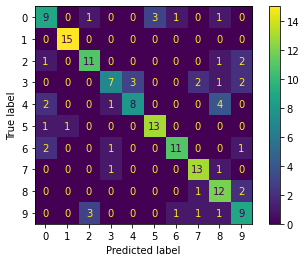

In [134]:
cm = confusion_matrix(y_test, y_pred_class_test_set,
                      labels = grid_multiLogistic.classes_)

disp = ConfusionMatrixDisplay(confusion_matrix = cm,
                              display_labels = grid_multiLogistic.classes_)
disp.plot()

In [135]:
print (f" Accuracy score onto our test set with our original model : {accuracy_score(y_test, y_pred_class_test_set) * 100} %.")

 Accuracy score onto our test set with our original model : 72.0 %.


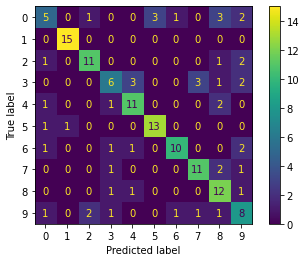

In [136]:
cm = confusion_matrix(y_test_pca, y_pred_class_test_set_pca,
                      labels = grid_multiLogistic_pca.classes_)

disp = ConfusionMatrixDisplay(confusion_matrix = cm,
                              display_labels = grid_multiLogistic_pca.classes_)
disp.plot()

In [137]:
print (f" Accuracy score onto our test set with our pca model : {accuracy_score(y_test_pca, y_pred_class_test_set_pca) * 100} %.")

 Accuracy score onto our test set with our pca model : 68.0 %.


## Support Vector Machine

In [85]:
import math
import time
from sklearn import svm

In [139]:
RepSKFold = RepeatedStratifiedKFold(n_splits = 5, n_repeats = 5, random_state = 42)

### Original dataset

#### Traing and validation sets

In [140]:
clfKernel = svm.SVC(kernel = "rbf", cache_size = 750, random_state = 42)

In [141]:
param_grid = {'C':[0.01, 0.025, 0.05, 0.1, 0.3, 0.7, 1, 5, 10],
              'gamma':[10, 1,0.1,0.01,0.001, "auto", "scale"],
              'kernel' : ['linear', 'poly', 'rbf', 'sigmoid'],
              'degree' : [1,2,3]
             }


gs = GridSearchCV(clfKernel,
                  param_grid,
                  scoring = 'accuracy',
                  n_jobs = -1,
                  refit = True,
                  cv = RepSKFold,
                  verbose = 3,
                  pre_dispatch = 'n_jobs',
                  return_train_score=False)

In [142]:
gs.fit(X_train, y_train)

Fitting 25 folds for each of 756 candidates, totalling 18900 fits
[CV 10/25] END ....C=0.01, degree=1, gamma=10, kernel=linear; total time=   0.1s
[CV 18/25] END ......C=0.01, degree=1, gamma=10, kernel=poly; total time=   0.0s
[CV 19/25] END ......C=0.01, degree=1, gamma=10, kernel=poly; total time=   0.0s
[CV 9/25] END ......C=0.01, degree=1, gamma=1, kernel=linear; total time=   0.0s
[CV 10/25] END .....C=0.01, degree=1, gamma=1, kernel=linear; total time=   0.0s
[CV 11/25] END .....C=0.01, degree=1, gamma=1, kernel=linear; total time=   0.0s
[CV 12/25] END .....C=0.01, degree=1, gamma=1, kernel=linear; total time=   0.0s
[CV 4/25] END ........C=0.01, degree=1, gamma=1, kernel=poly; total time=   0.0s
[CV 5/25] END ........C=0.01, degree=1, gamma=1, kernel=poly; total time=   0.0s
[CV 6/25] END ........C=0.01, degree=1, gamma=1, kernel=poly; total time=   0.0s
[CV 7/25] END ........C=0.01, degree=1, gamma=1, kernel=poly; total time=   0.0s
[CV 8/25] END ........C=0.01, degree=1, gam

GridSearchCV(cv=RepeatedStratifiedKFold(n_repeats=5, n_splits=5, random_state=42),
             estimator=SVC(cache_size=750, random_state=42), n_jobs=-1,
             param_grid={'C': [0.01, 0.025, 0.05, 0.1, 0.3, 0.7, 1, 5, 10],
                         'degree': [1, 2, 3],
                         'gamma': [10, 1, 0.1, 0.01, 0.001, 'auto', 'scale'],
                         'kernel': ['linear', 'poly', 'rbf', 'sigmoid']},
             pre_dispatch='n_jobs', scoring='accuracy', verbose=3)

In [143]:
print (f"Optimal hyper parameters: {gs.best_params_}.")

Optimal hyper parameters: {'C': 5, 'degree': 1, 'gamma': 0.01, 'kernel': 'rbf'}.


In [144]:
gs_df = pd.DataFrame(gs.cv_results_)

In [145]:
gs_df[gs_df['mean_test_score'] == max(gs_df['mean_test_score'])]

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_degree,param_gamma,param_kernel,params,split0_test_score,...,split18_test_score,split19_test_score,split20_test_score,split21_test_score,split22_test_score,split23_test_score,split24_test_score,mean_test_score,std_test_score,rank_test_score
602,0.038765,0.001213,0.013760,0.000646,5,1,0.01,rbf,"{'C': 5, 'degree': 1, 'gamma': 0.01, 'kernel':...",0.758824,...,0.711765,0.794118,0.729412,0.705882,0.835294,0.794118,0.741176,0.762353,0.032219,1
630,0.039030,0.001453,0.013549,0.000319,5,2,0.01,rbf,"{'C': 5, 'degree': 2, 'gamma': 0.01, 'kernel':...",0.758824,...,0.711765,0.794118,0.729412,0.705882,0.835294,0.794118,0.741176,0.762353,0.032219,1
658,0.038495,0.000956,0.013680,0.000756,5,3,0.01,rbf,"{'C': 5, 'degree': 3, 'gamma': 0.01, 'kernel':...",0.758824,...,0.711765,0.794118,0.729412,0.705882,0.835294,0.794118,0.741176,0.762353,0.032219,1


In [146]:
predicted_train = gs.predict(X_train)
predicted_test = gs.predict(X_test)

In [147]:
score_train = accuracy_score(y_train, predicted_train)
score_test = accuracy_score(y_test, predicted_test)

<Figure size 500x400 with 0 Axes>

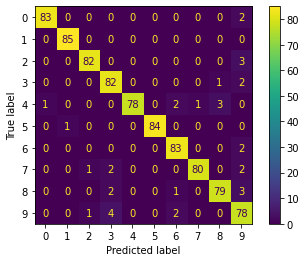

In [148]:
plt.figure(figsize = (10, 8), dpi= 50)

cm = confusion_matrix(y_train, predicted_train,
                      labels = gs.classes_)

disp = ConfusionMatrixDisplay(confusion_matrix = cm,
                              display_labels = gs.classes_)
disp.plot()
plt.show()

In [149]:
print('Accuracy for train set:%s' % (score_train))

Accuracy for train set:0.9576470588235294


<Figure size 500x400 with 0 Axes>

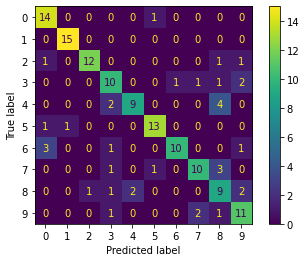

In [150]:
plt.figure(figsize = (10, 8), dpi= 50)

cm = confusion_matrix(y_test, predicted_test,
                      labels = gs.classes_)

disp = ConfusionMatrixDisplay(confusion_matrix = cm,
                              display_labels = gs.classes_)
disp.plot()
plt.show()

In [151]:
print('Accuracy for test set:%s' % (score_test))

Accuracy for test set:0.7533333333333333


In [86]:
#time to fit/predict

model = svm.SVC(kernel = "rbf", cache_size = 2000, gamma=0.01, random_state = 42, C=5)

start_fit = time.time()
model.fit(X_train, y_train)
interval_fit = time.time() - start_fit
print("fit time is:  "+str(interval_fit))

start_pred = time.time()
y_pred = model.predict(X_test)
interval = time.time() - start_pred
print("prediction time is:  "+str(interval))

fit time is:  0.03267526626586914
prediction time is:  0.008517980575561523


## XGBOOST

In [88]:
import xgboost as xgb #xgboost==1.3.3
from xgboost import XGBClassifier

### GRID SEARCHING

In [209]:
from sklearn.base import BaseEstimator, ClassifierMixin
from sklearn.utils.multiclass import unique_labels
from sklearn.utils.validation import check_array, check_X_y, check_is_fitted
class my_little_forest(BaseEstimator, ClassifierMixin):
    def __init__(self, learning_rate=0.025,max_depth=15, n_estimators=5, gamma=4, colsample_bytree=1, subsample=1):
        self.learning_rate=learning_rate
        self.max_depth=max_depth
        self.n_estimators=n_estimators
        self.gamma=gamma
        self.colsample_bytree=colsample_bytree
        self.subsample = subsample
        self.forest = []
    
    def fit(self, train_x, train_y):
        train_x, train_y = check_X_y(train_x, train_y)
        self.classes_= unique_labels(train_y)
        model = XGBClassifier(gamma=self.gamma ,learning_rate=self.learning_rate, max_depth=self.max_depth,use_label_encoder=False, n_estimators=self.n_estimators, eval_metric='mlogloss',colsample_bytree=self.colsample_bytree, subsample=self.subsample, n_jobs=8)
        #model = XGBClassifier(gamma=self.gamma ,learning_rate=self.learning_rate, max_depth=self.max_depth,use_label_encoder=False, n_estimators=self.n_estimators, eval_metric='mlogloss',colsample_bytree=self.colsample_bytree, subsample=self.subsample, n_jobs=-1)#, tree_method='gpu_hist', gpu_id=0)
        

        #start = time.time()
        model.fit(train_x, train_y.ravel())
        #print(time.time()-start)
        self.forest.append(model)
        return self

    def predict(self, Xtest):
        y_pred = self.forest[0].predict(Xtest)
        predictions = np.asarray([value for value in y_pred])
        #print(predictions)
        return predictions

    def bcr(self, Ytest, why):
        bcr = balanced_accuracy_score(Ytest, why)
        #print('BCR_final: ' + str(bcr))
        return bcr


In [211]:
#GRIDSEARCH
from sklearn.model_selection import GridSearchCV


data = pd.read_csv('features_30_sec.csv')
data.drop('filename', axis = 1, inplace = True)

labels = data.iloc[:, -1]
encoder = LabelEncoder()
target_encoded = encoder.fit_transform(labels)

X = StandardScaler().fit_transform(np.array(data.iloc[:, :-1], dtype = np.float64))
X_train, X_test, y_train, y_test = train_test_split(X, target_encoded, test_size= 0.15, stratify = target_encoded, random_state = 42)



learning_rate = [0.020, 0.025, 0.03]
max_depth = range(2,6, 1)
n_estimators = range(700, 1101, 100)
gamma = [0.0, 0.1, 1] #[0.0, 1] #
colsample_bytree = [0.6, 0.7, 0.8]
subsample = [0.6, 0.7, 0.8]
parameters = {'learning_rate':learning_rate, 'max_depth':max_depth, 'n_estimators':n_estimators, 'gamma':gamma, 'colsample_bytree':colsample_bytree, 'subsample':subsample}
mlf_gs = my_little_forest()
#gs = GridSearchCV(estimator=mlf_gs, param_grid= parameters, cv=3, n_jobs=1, verbose=4)
gs = GridSearchCV(estimator=mlf_gs, param_grid= parameters, cv=3, n_jobs=2, verbose=4)

gs=gs.fit(X_train, y_train)
gd_df = pd.DataFrame(gs.cv_results_)

def plot_columns(df, colname1, colname_target):
    x = df[colname1]
    y = df[colname_target]
    plt.plot(x, y)
    plt.show()
    return
#plot_columns(gd_df, "param_gamma","mean_test_score")

print(gs.best_params_)
print(pd.DataFrame(gs.cv_results_))
gd_df.to_csv("grid_search_res.csv")

Fitting 3 folds for each of 1620 candidates, totalling 4860 fits
[CV 1/3] END colsample_bytree=0.6, gamma=0.0, learning_rate=0.02, max_depth=2, n_estimators=700, subsample=0.6; total time=   2.0s
[CV 3/3] END colsample_bytree=0.6, gamma=0.0, learning_rate=0.02, max_depth=2, n_estimators=700, subsample=0.6; total time=   2.0s
[CV 2/3] END colsample_bytree=0.6, gamma=0.0, learning_rate=0.02, max_depth=2, n_estimators=700, subsample=0.7; total time=   2.1s
[CV 1/3] END colsample_bytree=0.6, gamma=0.0, learning_rate=0.02, max_depth=2, n_estimators=700, subsample=0.8; total time=   2.2s
[CV 3/3] END colsample_bytree=0.6, gamma=0.0, learning_rate=0.02, max_depth=2, n_estimators=700, subsample=0.8; total time=   2.3s
[CV 2/3] END colsample_bytree=0.6, gamma=0.0, learning_rate=0.02, max_depth=2, n_estimators=800, subsample=0.6; total time=   2.3s
[CV 1/3] END colsample_bytree=0.6, gamma=0.0, learning_rate=0.02, max_depth=2, n_estimators=800, subsample=0.7; total time=   2.4s
[CV 3/3] END colsa

### TESTING OUR BEST MODEL

In [89]:
model = XGBClassifier(gamma=0 ,learning_rate=0.025, max_depth=4,use_label_encoder=False, n_estimators=1000, eval_metric='mlogloss',colsample_bytree=0.7, subsample=0.8, n_jobs=2)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
from sklearn.metrics import accuracy_score
score = accuracy_score(y_pred, y_test)
print(score)


model.fit(X_train, y_train)
y_pred = model.predict(X_train)
from sklearn.metrics import accuracy_score
score = accuracy_score(y_pred, y_train)
print(score)



0.8
0.9988235294117647


In [96]:
df = pd.read_csv("grid_search_res.csv")
df[df["rank_test_score"]==1]

,Unnamed: 0,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_colsample_bytree,param_gamma,param_learning_rate,param_max_depth,param_n_estimators,param_subsample,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
1349,1349,4.671445,0.171472,0.00732,0.000227,0.8,0.1,0.025,3,1100,0.8,"{'colsample_bytree': 0.8, 'gamma': 0.1, 'learn...",0.827465,0.816254,0.805654,0.816458,0.008905,1


## SCALING

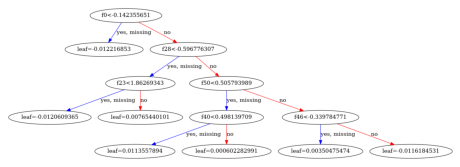

In [156]:
# %matplotlib inline
from xgboost import plot_tree
from matplotlib.pylab import rcParams

##set up the parameters
rcParams['figure.figsize'] = 8,5

plot_tree(model, num_trees=900)
plt.savefig('treeview_scaled.png', dpi=300)

plt.show()


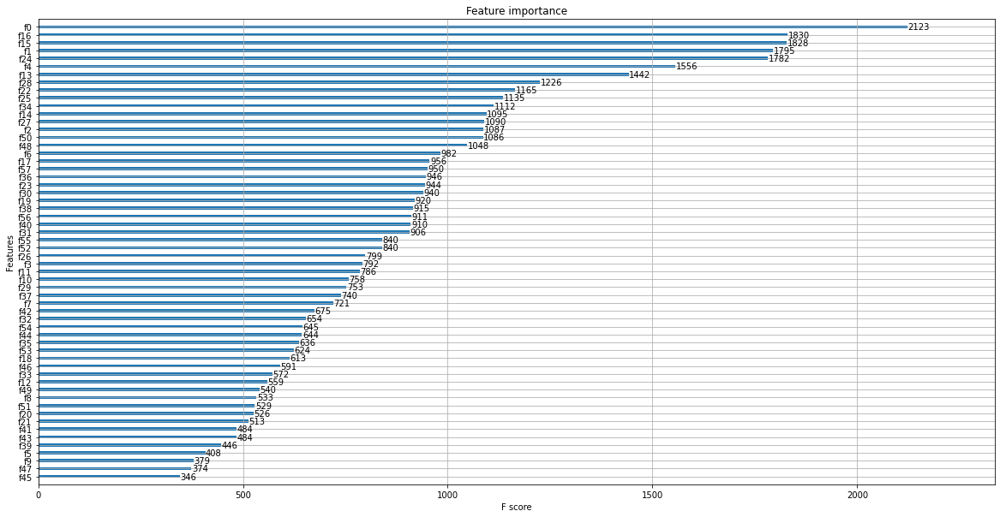

In [157]:
from xgboost import plot_tree, plot_importance
from matplotlib.pylab import rcParams

##set up the parameters
rcParams['figure.figsize'] = 20,10
plot_importance(model, ax=None, height=0.4, xlim=None, ylim=None, title='Feature importance', xlabel='F score', ylabel='Features', fmap='', importance_type='weight', max_num_features=None, grid=True, show_values=True)
plt.savefig('featuresimportance_scaled.png', dpi=300)
plt.show()

## NO SCALING

In [185]:
random.seed(42)
data = pd.read_csv('features_30_sec.csv')
data.drop('filename', axis = 1, inplace = True)


labels = data.iloc[:, -1].copy()

encoder = LabelEncoder()
target_encoded = encoder.fit_transform(labels)


X = data.iloc[:, :-1].copy()
X_train, X_test, y_train, y_test = train_test_split(X,
                                                    target_encoded,
                                                    test_size= 0.15,
                                                    stratify = target_encoded,
                                                    random_state = 42)

In [194]:
from sklearn.metrics import accuracy_score
import time

model = XGBClassifier(gamma=0 ,learning_rate=0.025, max_depth=4,use_label_encoder=False, n_estimators=1000, eval_metric='mlogloss',colsample_bytree=0.7, subsample=0.8, n_jobs=-1)
#model = XGBClassifier(gamma=0 ,learning_rate=0.025, max_depth=4,use_label_encoder=False, n_estimators=1000, eval_metric='mlogloss',colsample_bytree=0.7, subsample=0.8, n_jobs=-1, tree_method='gpu_hist', gpu_id=0)

start_fit = time.time()
model.fit(X_train, y_train)
interval_fit = time.time() - start_fit
print("fit time is:  "+str(interval_fit))

start_pred = time.time()
y_pred = model.predict(X_test)
interval = time.time() - start_pred
print("prediction time is:  "+str(interval))

score = accuracy_score(y_pred, y_test)
print(score)


fit time is:  4.890766143798828
prediction time is:  0.010120391845703125
0.8


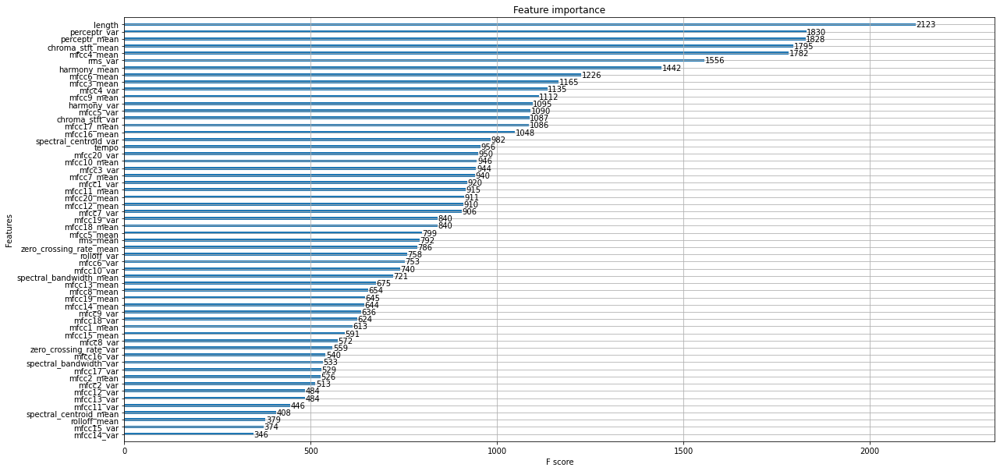

In [160]:
from matplotlib.pylab import rcParams
from xgboost import plot_tree, plot_importance

##set up the parameters
rcParams['figure.figsize'] = 20,10
plot_importance(model, ax=None, height=0.4, xlim=None, ylim=None, title='Feature importance', xlabel='F score', ylabel='Features', fmap='', importance_type='weight', max_num_features=None, grid=True, show_values=True)
plt.savefig('featuresimportance_notscaled.png', dpi=300)
plt.show()

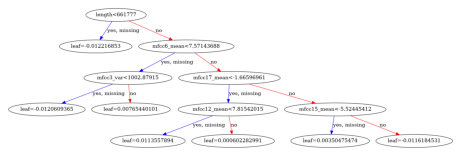

In [161]:
# %matplotlib inline
from xgboost import plot_tree
from matplotlib.pylab import rcParams

##set up the parameters
rcParams['figure.figsize'] = 8,5

plot_tree(model, num_trees=900)
plt.savefig('treeview_notscaled.png', dpi=300)

plt.show()


# LSTM

In [40]:
#data repreparation
X_train_lstm, X_val, y_train_lstm, y_val = train_test_split(X_train, y_train,
                                                    test_size= 0.20,
                                                    stratify = y_train,
                                                    random_state = 42)


X_train_resh = np.copy(np.array(X_train_lstm).reshape((X_train_lstm.shape[0], 1, X_train_lstm.shape[1])))
X_val = np.copy(np.array(X_val).reshape((X_val.shape[0], 1, X_val.shape[1])))
X_test_resh = np.copy(np.array(X_test).reshape((X_test.shape[0], 1, X_test.shape[1])))

In [41]:
#TUNER FROM Keras Tuner
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from keras import backend as K
import keras_tuner as kt
from keras.models import Sequential
from keras.layers import Dense, Dropout, LSTM

In [42]:
gpu = tf.config.list_physical_devices('GPU')
tf.config.experimental.set_memory_growth(device=gpu[0], enable=True)

2021-12-16 10:32:10.160501: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2021-12-16 10:32:10.204274: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-16 10:32:10.204540: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: GeForce RTX 2080 SUPER computeCapability: 7.5
coreClock: 1.815GHz coreCount: 48 deviceMemorySize: 7.79GiB deviceMemoryBandwidth: 462.00GiB/s
2021-12-16 10:32:10.204570: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2021-12-16 10:32:10.237628: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcublas.so.10
2021-12-16 10:32:10.255897: I tensorflow/stream_executor/plat

### Grid Searching

In [51]:
def build_model(hp):
    input_shape=(X_train_resh.shape[1:])
    num_classes = 10

    model = Sequential()
    
    #first layer
    model.add(LSTM(hp.Int("units l1", min_value=50, max_value=150, step=20),return_sequences=True, activation="tanh",input_shape=input_shape))
    
    
    if hp.Boolean("dropout 1"):
        model.add(layers.Dropout(rate=hp.Float("units dropout 1", min_value=0.1, max_value=0.2, step=0.1)))
    
    #third layer?
    alreadydropout=False
    if hp.Boolean("3 layer"):
        model.add(LSTM(hp.Int("units l3 (optionnal)", min_value=30, max_value=200, step=30),return_sequences=True, activation="tanh",input_shape=input_shape))
        if hp.Boolean("dropout l3"):
            model.add(layers.Dropout(rate=hp.Float("units dropout l3", min_value=0.1, max_value=0.2, step=0.1)))
            alreadydropout=True
        

    #dropout 
    if not alreadydropout and hp.Boolean("dropout 2"):
        model.add(layers.Dropout(rate=hp.Float("units dropout 2", min_value=0.1, max_value=0.2, step=0.1)))
    
    model.add(LSTM(hp.Int("units l2", min_value=50, max_value=120, step=20), return_sequences=False, activation="tanh"))
    
    

    model.add(Dense(hp.Int("units dense1", min_value=30, max_value=40, step=10), activation="relu"))

    model.add(Dense(hp.Int("units dense2", min_value=20, max_value=40, step=10), activation="relu"))
    
    model.add(Dense(num_classes, activation="softmax"))
    
    #activation=hp.Choice("activation", ["relu", "tanh"])
    opt = tf.keras.optimizers.Adam(lr=hp.Float('learning_rate', min_value=1e-3, max_value=1e-2, sampling='LOG', default=1e-3),amsgrad=hp.Boolean("amsgrad variant"))
    
    model.compile(loss='sparse_categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
    return model

In [52]:
tuner = kt.BayesianOptimization(
    hypermodel=build_model,
    objective="val_accuracy",
    max_trials=400,
    executions_per_trial=1,
    overwrite=True,
    directory="res_lstm",
    project_name="test_1",
)
tuner.search_space_summary()

Search space summary
Default search space size: 9
units l1 (Int)
{'default': None, 'conditions': [], 'min_value': 50, 'max_value': 150, 'step': 20, 'sampling': None}
dropout 1 (Boolean)
{'default': False, 'conditions': []}
3 layer (Boolean)
{'default': False, 'conditions': []}
dropout 2 (Boolean)
{'default': False, 'conditions': []}
units l2 (Int)
{'default': None, 'conditions': [], 'min_value': 50, 'max_value': 120, 'step': 20, 'sampling': None}
units dense1 (Int)
{'default': None, 'conditions': [], 'min_value': 30, 'max_value': 40, 'step': 10, 'sampling': None}
units dense2 (Int)
{'default': None, 'conditions': [], 'min_value': 20, 'max_value': 40, 'step': 10, 'sampling': None}
learning_rate (Float)
{'default': 0.001, 'conditions': [], 'min_value': 0.001, 'max_value': 0.01, 'step': None, 'sampling': 'log'}
amsgrad variant (Boolean)
{'default': False, 'conditions': []}


In [53]:
tuner.search(X_train_resh, y_train_lstm, epochs=200, validation_data=(X_val, y_val), batch_size=20,  verbose=2,callbacks=[tf.keras.callbacks.EarlyStopping('val_loss', restore_best_weights=False, patience=20)])

Trial 400 Complete [00h 00m 05s]
val_accuracy: 0.7647058963775635

Best val_accuracy So Far: 0.8058823347091675
Total elapsed time: 03h 31m 17s
INFO:tensorflow:Oracle triggered exit


In [54]:
# Our best model
models = tuner.get_best_models(num_models=1)
best_model = models[0]

### Testing our best lstm

In [55]:
best_model.build(input_shape=(X_train.shape[1:]))
print()
print()
print(best_model.summary())
print()
print()
print()
print()
print(tuner.results_summary())



Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm (LSTM)                  (None, 1, 150)            125400    
_________________________________________________________________
dropout (Dropout)            (None, 1, 150)            0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 110)               114840    
_________________________________________________________________
dense (Dense)                (None, 40)                4440      
_________________________________________________________________
dense_1 (Dense)              (None, 40)                1640      
_________________________________________________________________
dense_2 (Dense)              (None, 10)                410       
Total params: 246,730
Trainable params: 246,730
Non-trainable params: 0
________________________________________________

In [67]:
def best_model():
    input_shape = (X_train_resh.shape[1:])
    best_model_version = Sequential()
    best_model_version.add(LSTM(150,return_sequences=True, activation="tanh",input_shape=input_shape))
    best_model_version.add(layers.Dropout(rate=0.1))
    best_model_version.add(LSTM(60, return_sequences=False, activation="tanh"))
    best_model_version.add(layers.Dropout(rate=0.1))
    best_model_version.add(Dense(40, activation="relu"))
    best_model_version.add(Dense(40, activation="relu"))
    best_model_version.add(Dense(10, activation="softmax"))

    opt = tf.keras.optimizers.Adam(lr=3e-3, decay=1e-5)
    best_model_version.compile(loss='sparse_categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
    return best_model_version

In [68]:
# CHECK VALIDATION DATA
best_model_version = best_model()

In [69]:
history = best_model_version.fit(x=X_train_resh, y=y_train_lstm, batch_size=20, epochs=100, validation_data=(X_val, y_val))

Epoch 1/100
34/34 [==============================] - 1s 16ms/step - loss: 2.0298 - accuracy: 0.3147 - val_loss: 1.6681 - val_accuracy: 0.3588
Epoch 2/100
34/34 [==============================] - 0s 3ms/step - loss: 1.4123 - accuracy: 0.4721 - val_loss: 1.3430 - val_accuracy: 0.4471
Epoch 3/100
34/34 [==============================] - 0s 3ms/step - loss: 1.0908 - accuracy: 0.6044 - val_loss: 1.1742 - val_accuracy: 0.5941
Epoch 4/100
34/34 [==============================] - 0s 3ms/step - loss: 0.9242 - accuracy: 0.6603 - val_loss: 1.1136 - val_accuracy: 0.6294
Epoch 5/100
34/34 [==============================] - 0s 3ms/step - loss: 0.7347 - accuracy: 0.7191 - val_loss: 1.0858 - val_accuracy: 0.6529
Epoch 6/100
34/34 [==============================] - 0s 3ms/step - loss: 0.5974 - accuracy: 0.7676 - val_loss: 0.9474 - val_accuracy: 0.6882
Epoch 7/100
34/34 [==============================] - 0s 3ms/step - loss: 0.4752 - accuracy: 0.8279 - val_loss: 1.0480 - val_accuracy: 0.6941
Epoch 8/100


dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])

0.7823529243469238
50


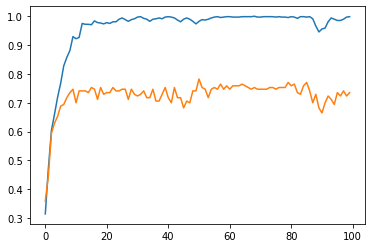

In [70]:
#checking learning curves
print(history.history.keys())
print()
print(max(history.history["val_accuracy"]))
print(np.argmax(history.history["val_accuracy"]))
plt.plot(history.history["accuracy"])
plt.plot(history.history["val_accuracy"])
plt.show()

In [66]:
#CHECK MODEL TRAINED ON FULL TRAINING SET
#AND EVALUATED ON TEST SET
import time
X_reshaped = np.copy(np.array(X_train).reshape((X_train.shape[0], 1, X_train.shape[1])))
best_model_version = best_model()

start=time.time()
history = best_model_version.fit(x=X_reshaped, y=y_train, batch_size=20, epochs=100, verbose=0)
interval_fit = str(time.time()-start)
print('fit time is:  '+ interval_fit)

start=time.time()
best_model_version.evaluate(x=X_test_resh, y=y_test)
interval_pred = str(time.time()-start)
print('pred time is:  '+ interval_pred)

fit time is:  25.085251569747925
5/5 [==============================] - 0s 1ms/step - loss: 1.9760 - accuracy: 0.7000
pred time is:  0.5229690074920654


In [176]:
K.clear_session()